# PyMMM: Python Mother Machine Manager

In [1]:
from Experiment.experiment import * 
import re
import shutil

In [2]:
os.getcwd()

'/mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments'

Increase file limit to prevent crashes with large experiments

In [3]:
import resource

# Set the file descriptor limit
soft, hard = resource.getrlimit(resource.RLIMIT_NOFILE)
print(f"Current soft limit: {soft}, hard limit: {hard}")

# Increase the soft limit to the new value
resource.setrlimit(resource.RLIMIT_NOFILE, (16384, hard))

# Verify the new limits
soft, hard = resource.getrlimit(resource.RLIMIT_NOFILE)
print(f"New soft limit: {soft}, hard limit: {hard}")

Current soft limit: 4096, hard limit: 1048576
New soft limit: 16384, hard limit: 1048576


In [4]:
!ulimit -n

16384


The first thing to do is to define your experiment's directory, and instantite an `Experiment` object using that directory.
Let's also print the experiment's properties

In [5]:
directory = os.getcwd()

In [6]:
my_experiment = Experiment(
    directory,  
    save_filetype="png"
)
print(my_experiment)


            Experiment name: 2025_11_27_40x_persister_1HourAmpicillinTreatments
            Channels: ['PC']
            Timepoints: 321
            FOVs: 159
            Registered: True
        


/mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments/Experiment/experiment.py:111: UserWarning: No mean_amount attribute set. Taking image means over all timepoints. Very slow!
  warnings.warn("No mean_amount attribute set. Taking image means over all timepoints. Very slow!")


Here, we can choose the times and FOVs to take forward for registration

In [7]:
my_experiment.FOVs

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


In [8]:
# Uncomment as needed

# my_experiment.set_analysis_times(0, 50)

# my_experiment.discard_FOVs([f"xy{str(x).zfill(3)}" for x in range(148, 158)]) 

# # Manually check FOVs in imageJ/napari and add to list
# discard_FOVs = []
# discard_FOVs = [f"xy{str(x).zfill(3)}" for x in discard_FOVs]
# my_experiment.discard_FOVs(discard_FOVs)

my_experiment.FOVs

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


In [9]:
my_experiment.times

['T0000',
 'T0001',
 'T0002',
 'T0003',
 'T0004',
 'T0005',
 'T0006',
 'T0007',
 'T0008',
 'T0009',
 'T0010',
 'T0011',
 'T0012',
 'T0013',
 'T0014',
 'T0015',
 'T0016',
 'T0017',
 'T0018',
 'T0019',
 'T0020',
 'T0021',
 'T0022',
 'T0023',
 'T0024',
 'T0025',
 'T0026',
 'T0027',
 'T0028',
 'T0029',
 'T0030',
 'T0031',
 'T0032',
 'T0033',
 'T0034',
 'T0035',
 'T0036',
 'T0037',
 'T0038',
 'T0039',
 'T0040',
 'T0041',
 'T0042',
 'T0043',
 'T0044',
 'T0045',
 'T0046',
 'T0047',
 'T0048',
 'T0049',
 'T0050',
 'T0051',
 'T0052',
 'T0053',
 'T0054',
 'T0055',
 'T0056',
 'T0057',
 'T0058',
 'T0059',
 'T0060',
 'T0061',
 'T0062',
 'T0063',
 'T0064',
 'T0065',
 'T0066',
 'T0067',
 'T0068',
 'T0069',
 'T0070',
 'T0071',
 'T0072',
 'T0073',
 'T0074',
 'T0075',
 'T0076',
 'T0077',
 'T0078',
 'T0079',
 'T0080',
 'T0081',
 'T0082',
 'T0083',
 'T0084',
 'T0085',
 'T0086',
 'T0087',
 'T0088',
 'T0089',
 'T0090',
 'T0091',
 'T0092',
 'T0093',
 'T0094',
 'T0095',
 'T0096',
 'T0097',
 'T0098',
 'T0099',


In [10]:
# Uncomment as needed

# my_experiment.times.remove('T0000')
# my_experiment.times.remove('T0002')
# my_experiment.times.remove('T0043')

### Let's now ensure the quality of the data

We're going to register the images to minimise the effects of stage drift.

* First we will set the experiment's registration channel, here we are using `"PC"` for phase contrast.

In [11]:
my_experiment.registration_channel = "PC"

Next we will do two things:
* The first is to calculate mean images for the experiment. These are average images which will be used for image registration
* By default, PyMMM takes an average over the last 15 images of the experiment, as the experiment's stage drift has likely stopped by then.
* We can also rotate the mean image if the experiment was not properly aligned. This will rotate the mean images, and all other images will be registered against them, rotating them in the process.
* Let's just check our experiment without the rotation argument.

In [12]:
my_experiment.mean_amount = 1

  0%|          | 0/159 [00:00<?, ?it/s]

Mean images for 159 FOVs with rotation of 0 deg calculated, use the mean_images method to return a dict of mean images


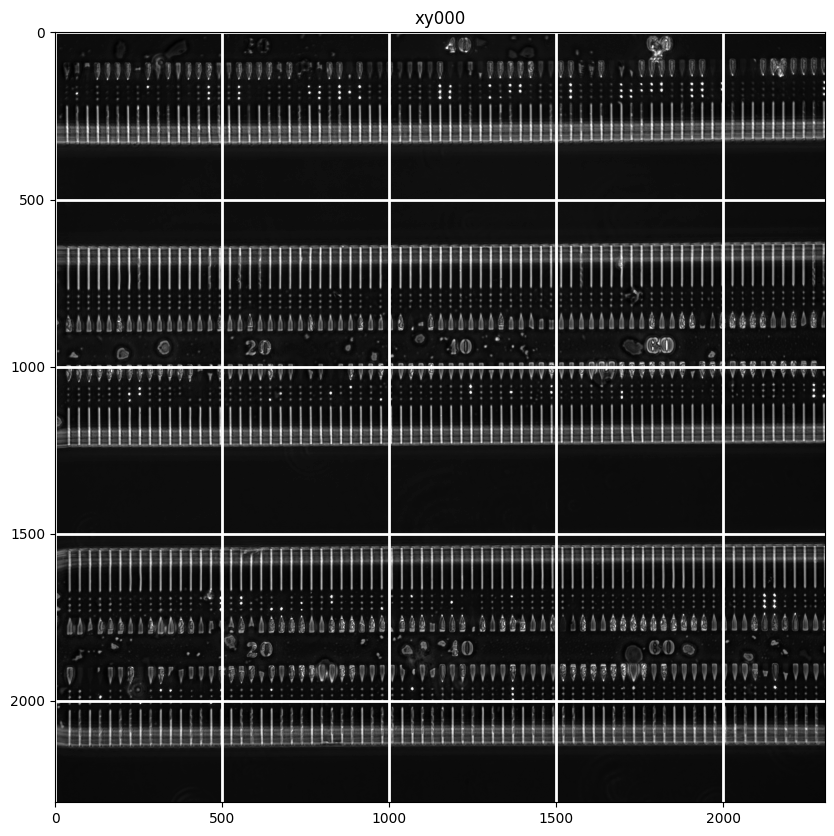

In [13]:
my_experiment.get_mean_images(plot = True)

It looks like there's some rotation in our experiment. Let's rotate the images and recalculate the mean images.

  0%|          | 0/159 [00:00<?, ?it/s]

Mean images for 159 FOVs with rotation of -0.25 deg calculated, use the mean_images method to return a dict of mean images


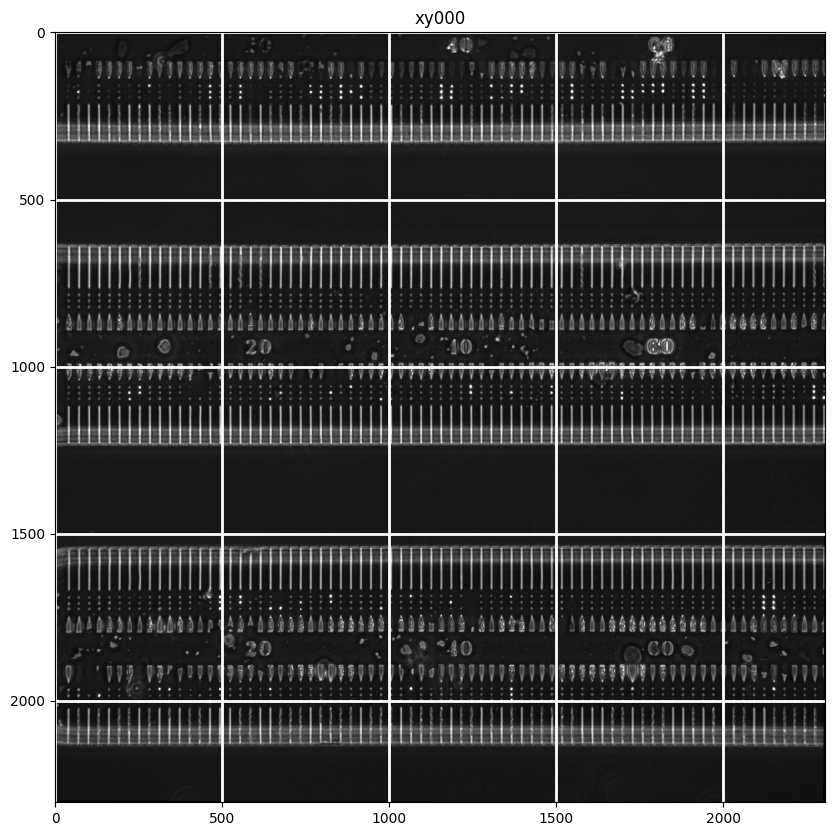

In [19]:
my_experiment.get_mean_images(rotation = -0.25, plot = True)

That's looking much better.
* We can now register the images. We only need to do this once, so we can check whether the experiment has already been registered with the `is_registered` property.
* Here we check if an experiment is registered, and not, we register it with all of our CPU cores.
* There is also a `force` argument, which if set to `True` will overwrite any previous registered images.

  0%|          | 0/159 [00:00<?, ?it/s]

  0%|          | 0/320 [00:00<?, ?it/s]

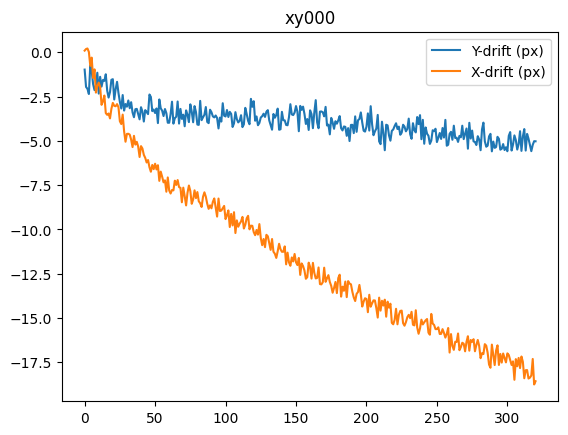

  0%|          | 0/320 [00:00<?, ?it/s]

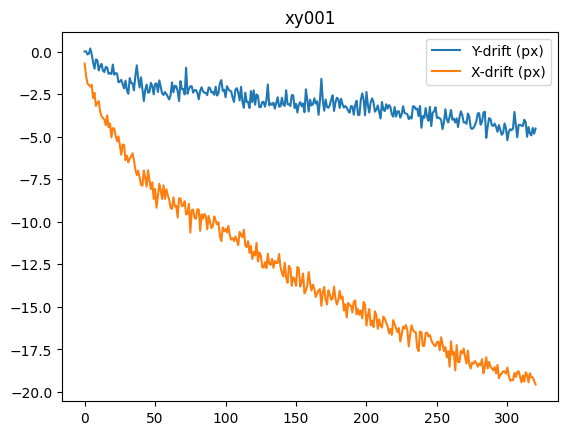

  0%|          | 0/320 [00:00<?, ?it/s]

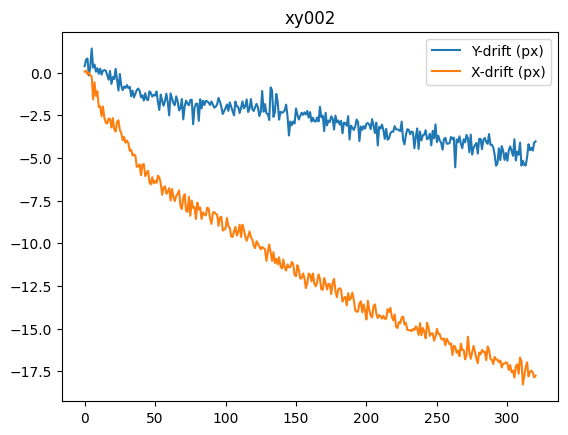

  0%|          | 0/320 [00:00<?, ?it/s]

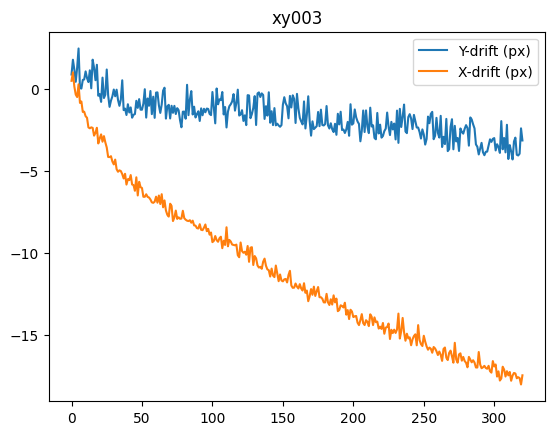

  0%|          | 0/320 [00:00<?, ?it/s]

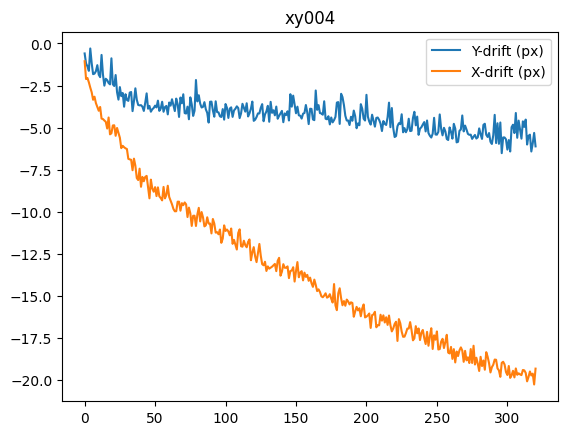

  0%|          | 0/320 [00:00<?, ?it/s]

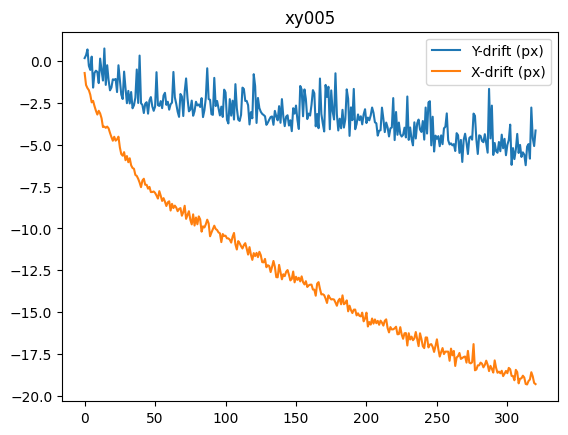

  0%|          | 0/320 [00:00<?, ?it/s]

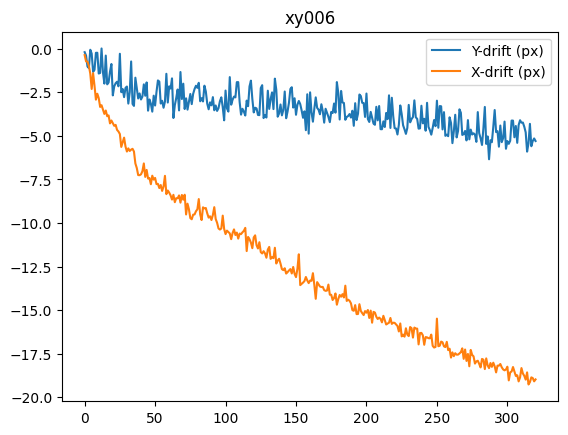

  0%|          | 0/320 [00:00<?, ?it/s]

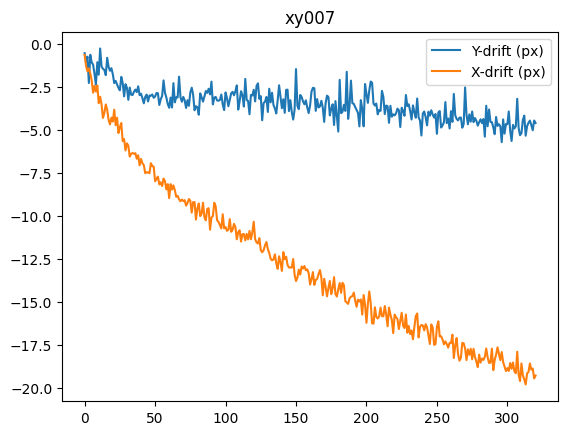

  0%|          | 0/320 [00:00<?, ?it/s]

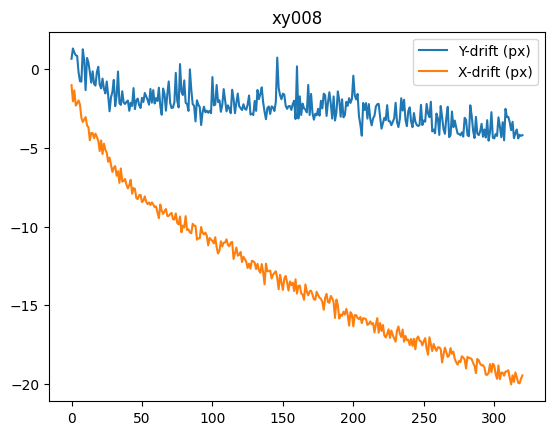

  0%|          | 0/320 [00:00<?, ?it/s]

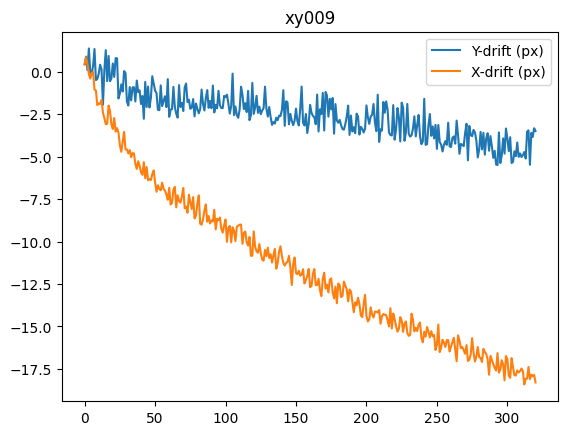

  0%|          | 0/320 [00:00<?, ?it/s]

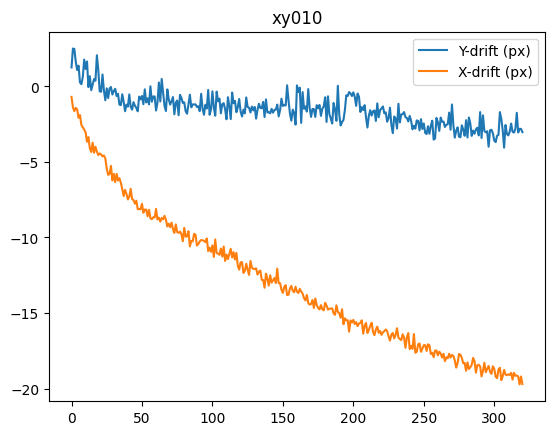

  0%|          | 0/320 [00:00<?, ?it/s]

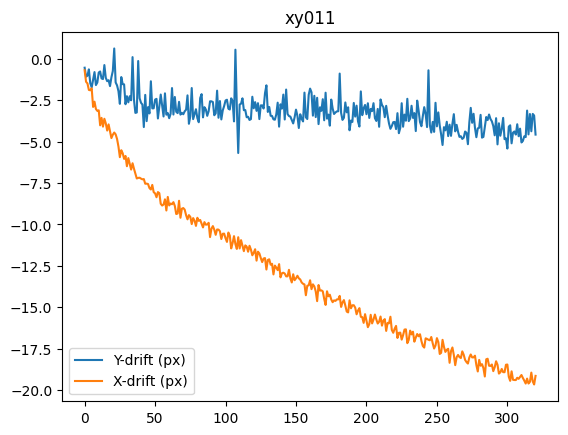

  0%|          | 0/320 [00:00<?, ?it/s]

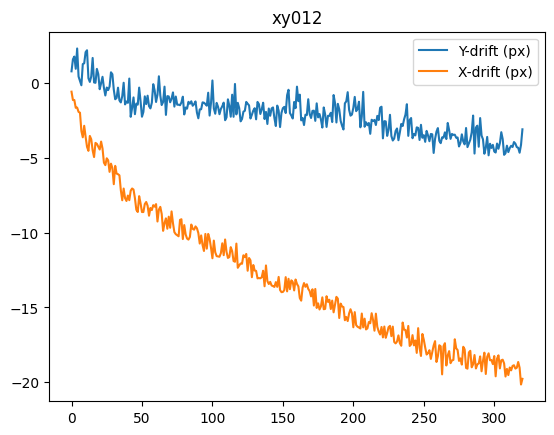

  0%|          | 0/320 [00:00<?, ?it/s]

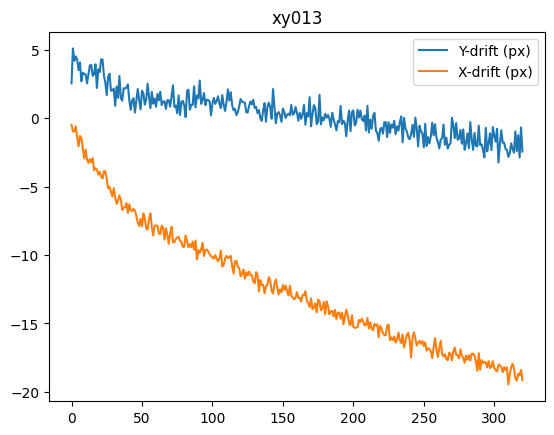

  0%|          | 0/320 [00:00<?, ?it/s]

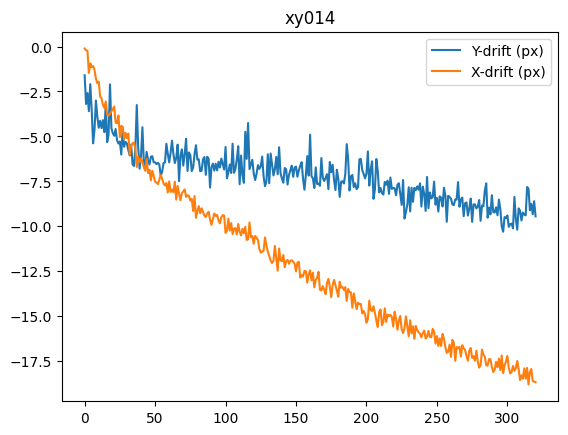

  0%|          | 0/320 [00:00<?, ?it/s]

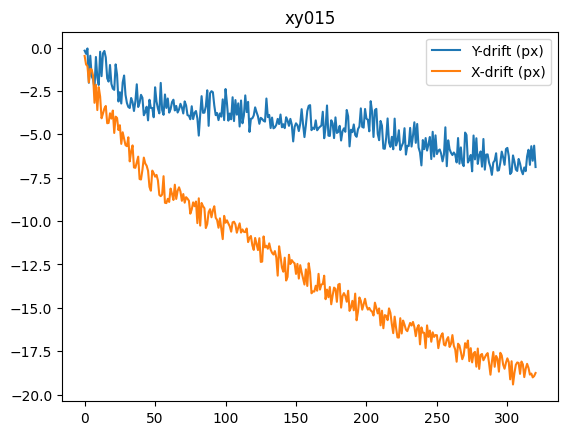

  0%|          | 0/320 [00:00<?, ?it/s]

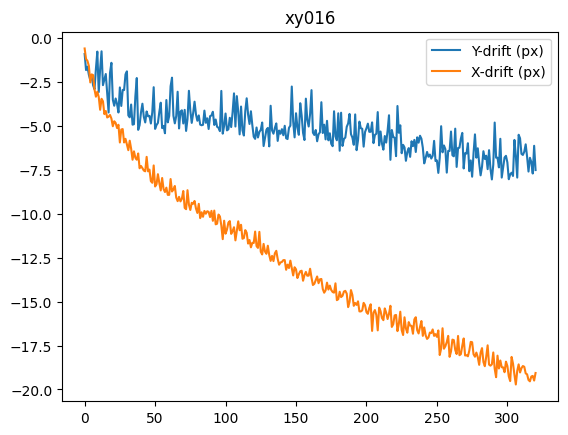

  0%|          | 0/320 [00:00<?, ?it/s]

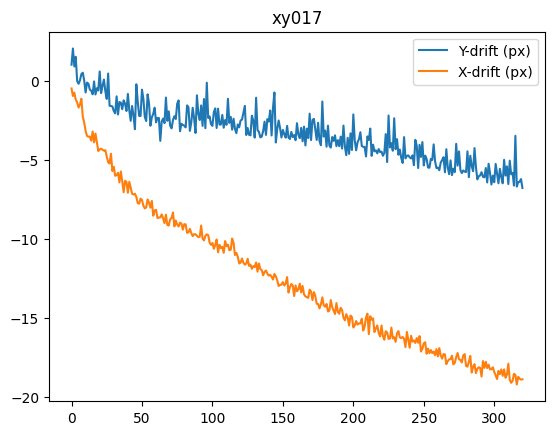

  0%|          | 0/320 [00:00<?, ?it/s]

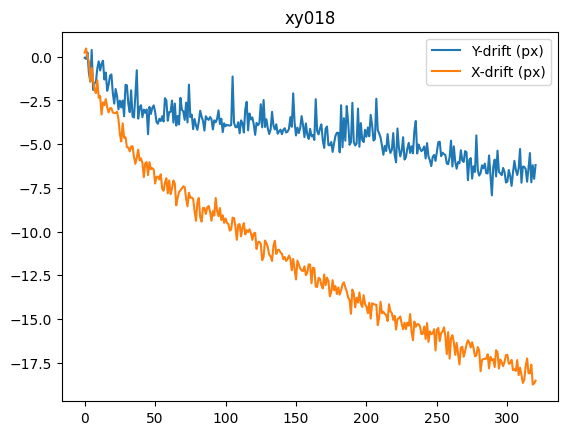

  0%|          | 0/320 [00:00<?, ?it/s]

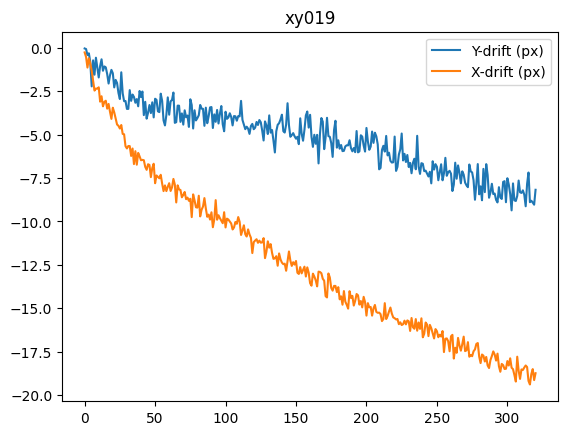

  0%|          | 0/320 [00:00<?, ?it/s]

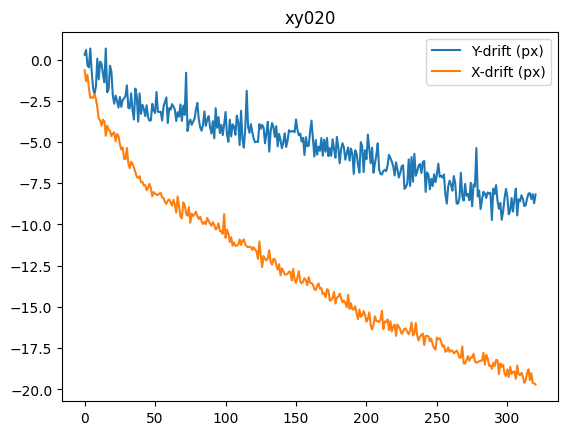

  0%|          | 0/320 [00:00<?, ?it/s]

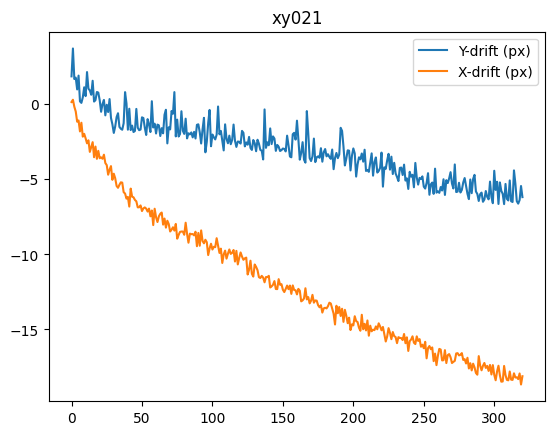

  0%|          | 0/320 [00:00<?, ?it/s]

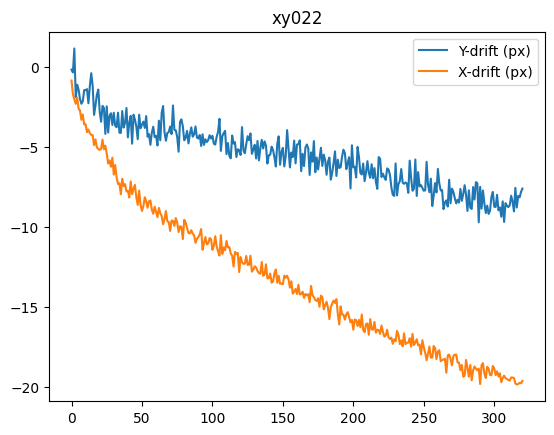

  0%|          | 0/320 [00:00<?, ?it/s]

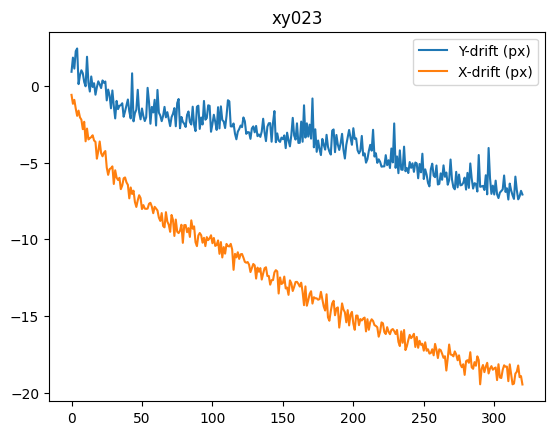

  0%|          | 0/320 [00:00<?, ?it/s]

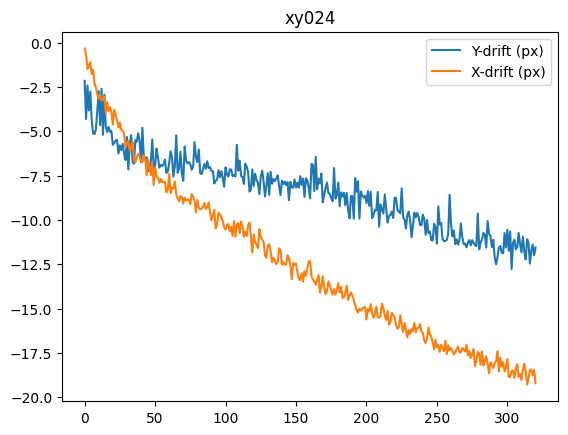

  0%|          | 0/320 [00:00<?, ?it/s]

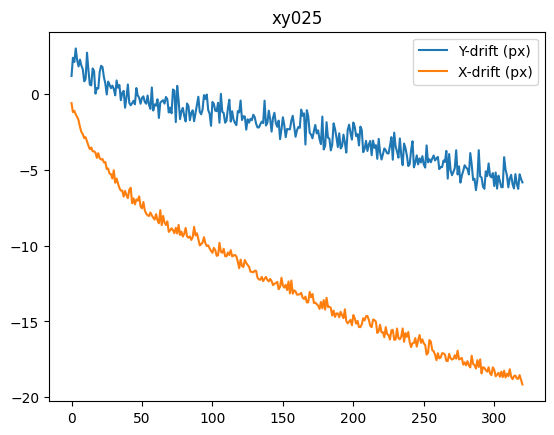

  0%|          | 0/320 [00:00<?, ?it/s]

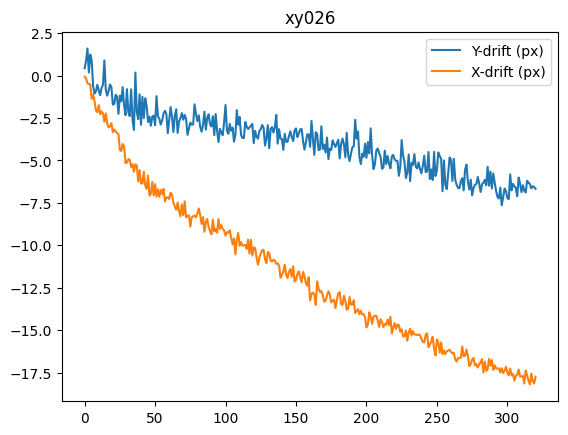

  0%|          | 0/320 [00:00<?, ?it/s]

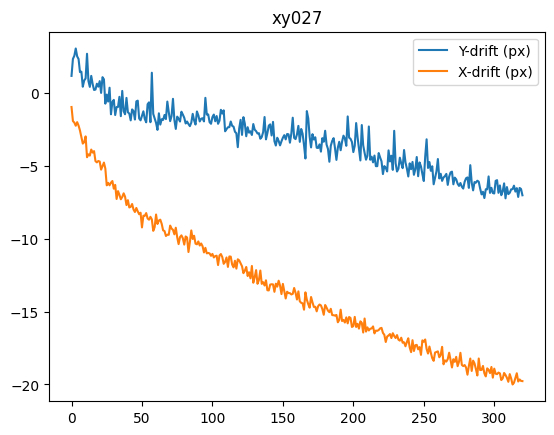

  0%|          | 0/320 [00:00<?, ?it/s]

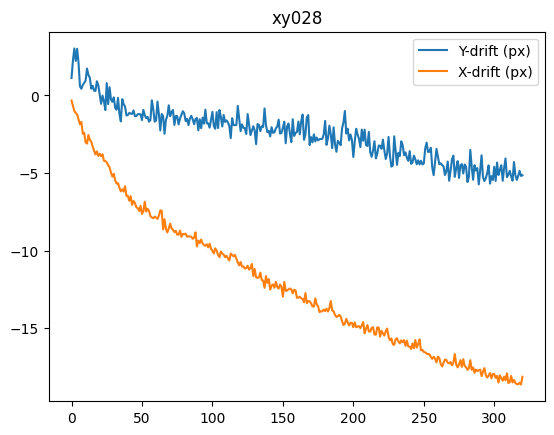

  0%|          | 0/320 [00:00<?, ?it/s]

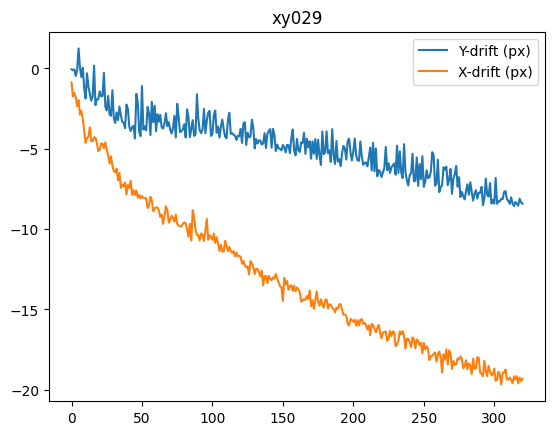

  0%|          | 0/320 [00:00<?, ?it/s]

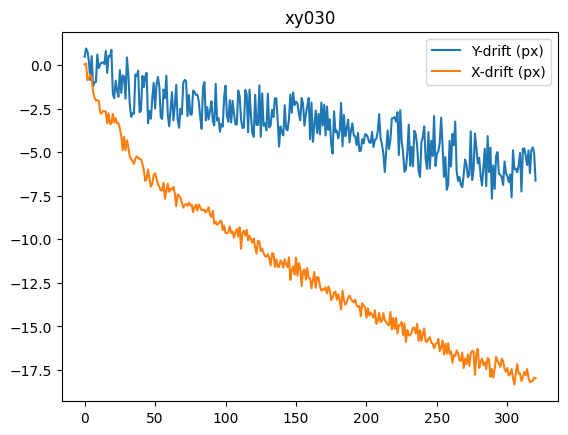

  0%|          | 0/320 [00:00<?, ?it/s]

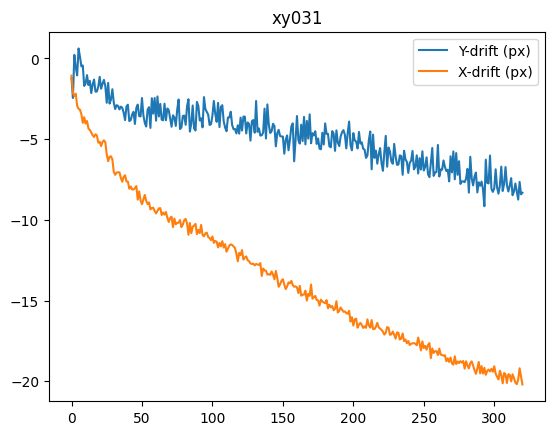

  0%|          | 0/320 [00:00<?, ?it/s]

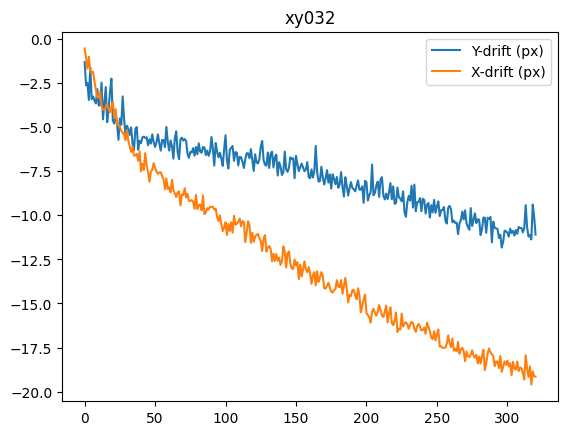

  0%|          | 0/320 [00:00<?, ?it/s]

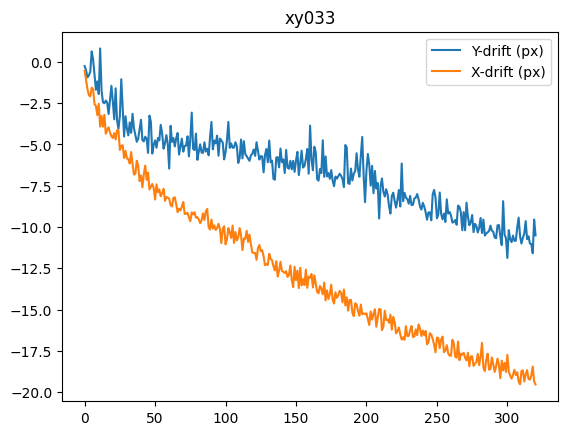

  0%|          | 0/320 [00:00<?, ?it/s]

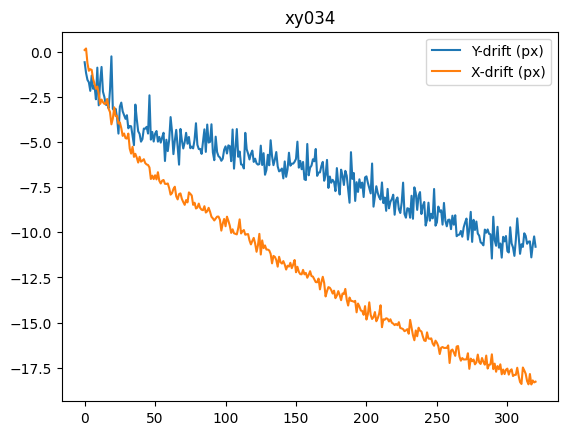

  0%|          | 0/320 [00:00<?, ?it/s]

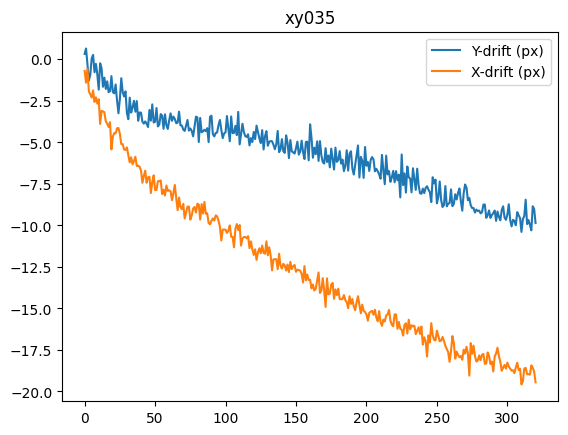

  0%|          | 0/320 [00:00<?, ?it/s]

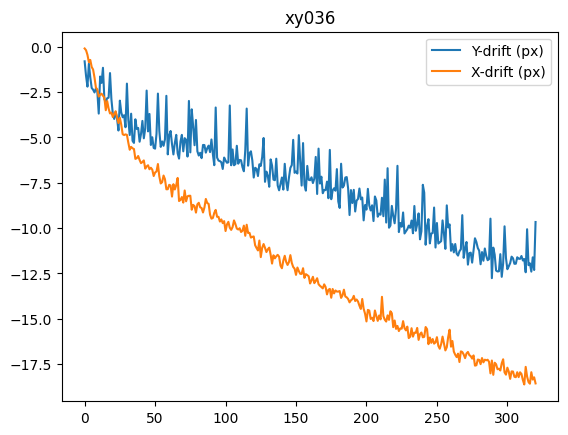

  0%|          | 0/320 [00:00<?, ?it/s]

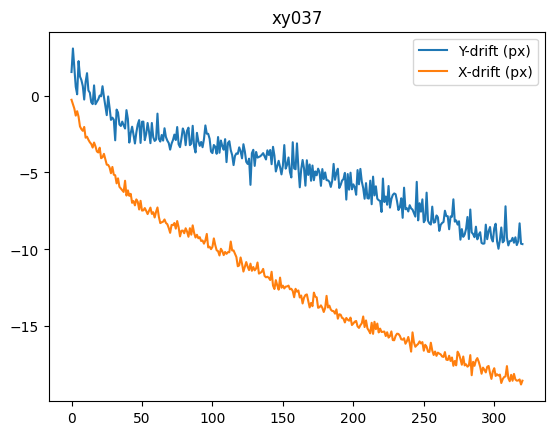

  0%|          | 0/320 [00:00<?, ?it/s]

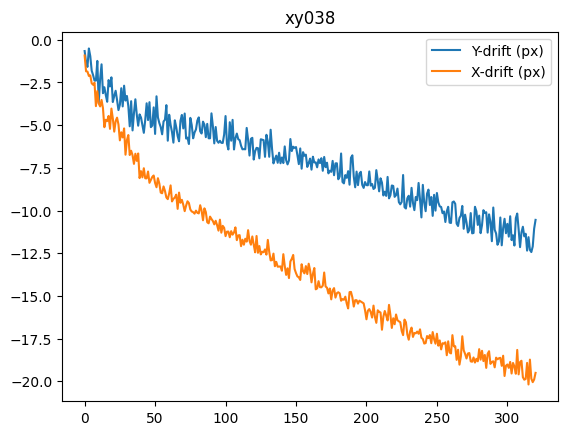

  0%|          | 0/320 [00:00<?, ?it/s]

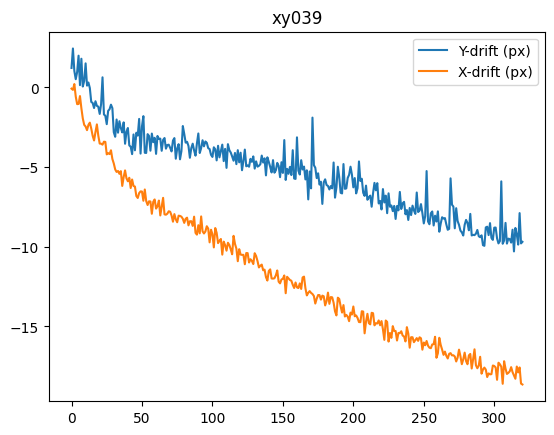

  0%|          | 0/320 [00:00<?, ?it/s]

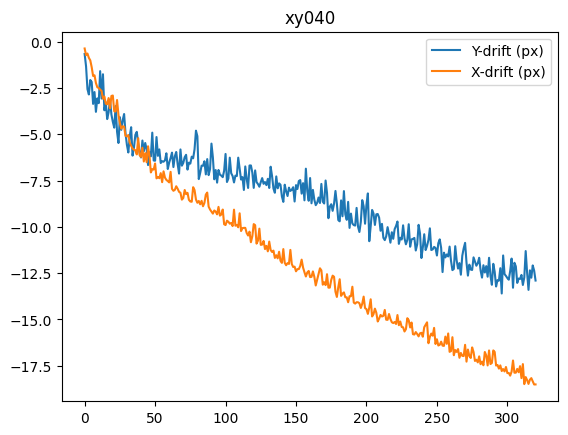

  0%|          | 0/320 [00:00<?, ?it/s]

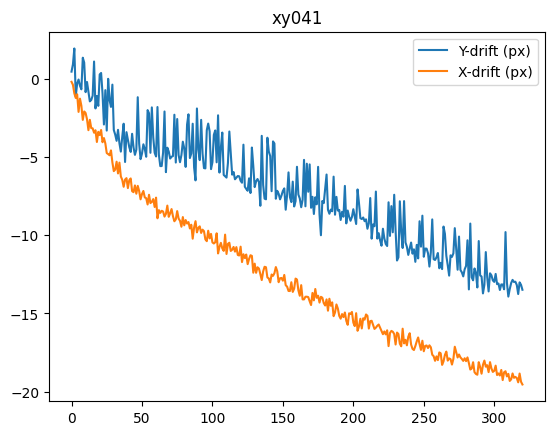

  0%|          | 0/320 [00:00<?, ?it/s]

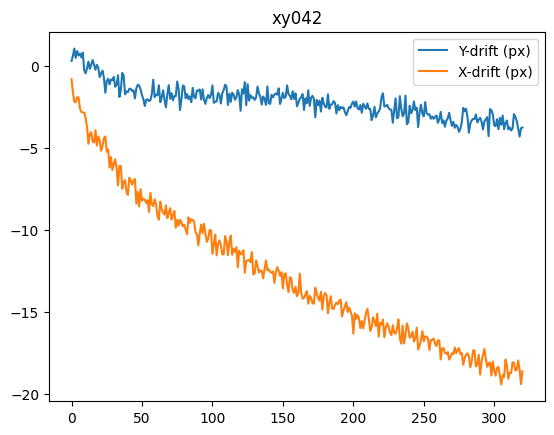

  0%|          | 0/320 [00:00<?, ?it/s]

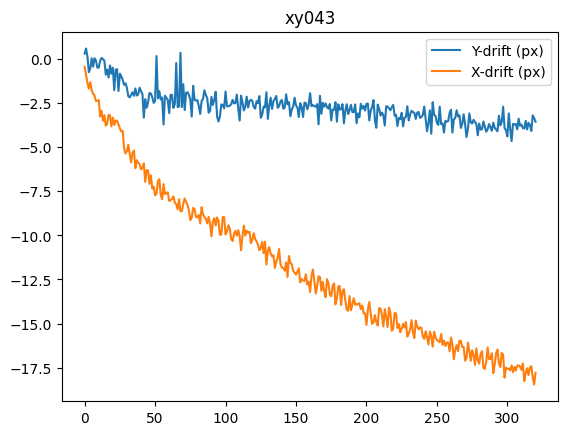

  0%|          | 0/320 [00:00<?, ?it/s]

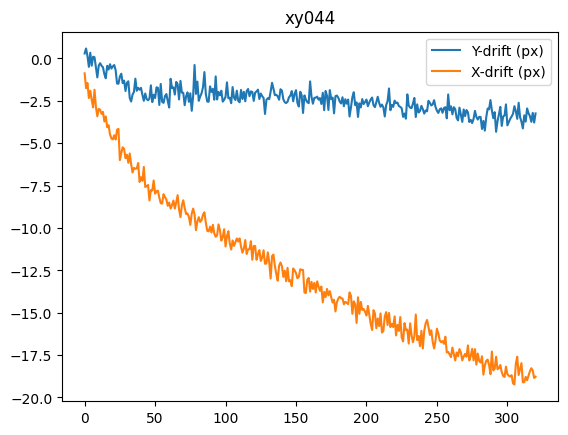

  0%|          | 0/320 [00:00<?, ?it/s]

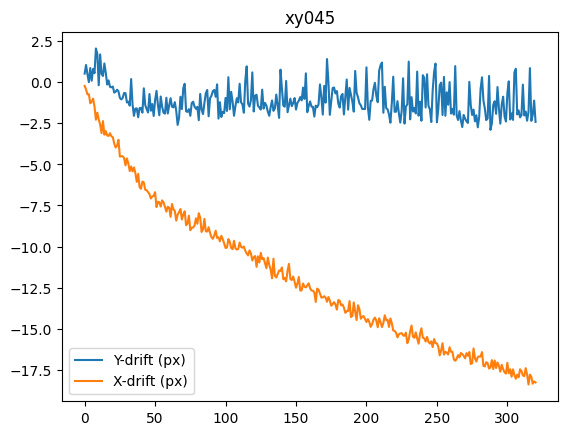

  0%|          | 0/320 [00:00<?, ?it/s]

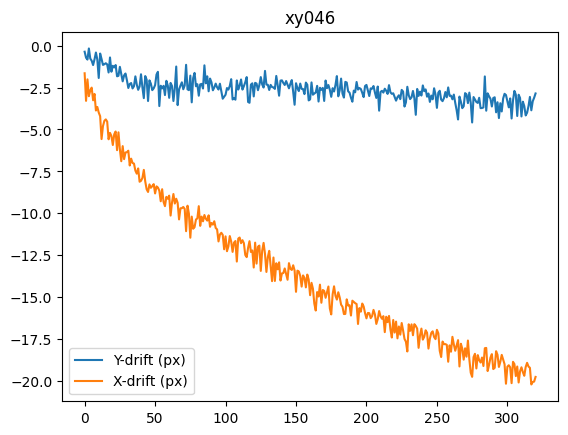

  0%|          | 0/320 [00:00<?, ?it/s]

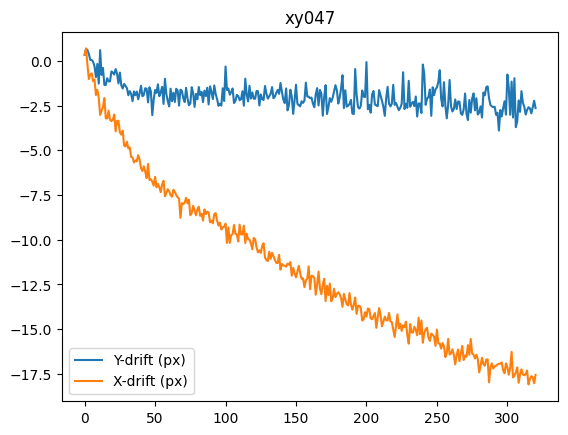

  0%|          | 0/320 [00:00<?, ?it/s]

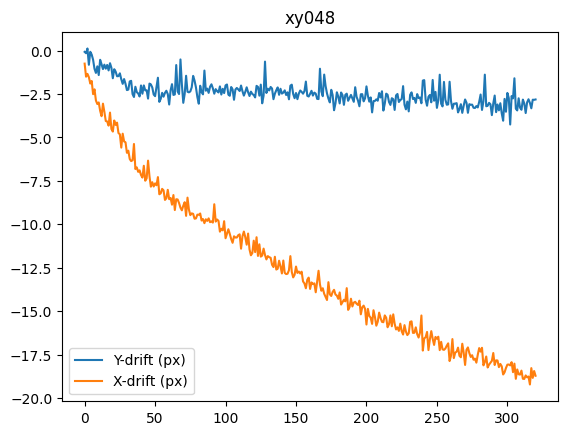

  0%|          | 0/320 [00:00<?, ?it/s]

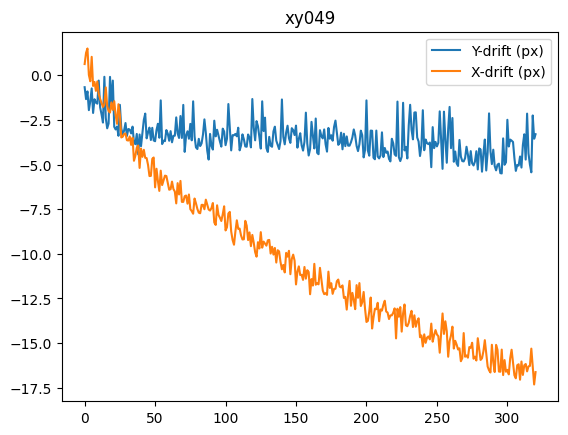

  0%|          | 0/320 [00:00<?, ?it/s]

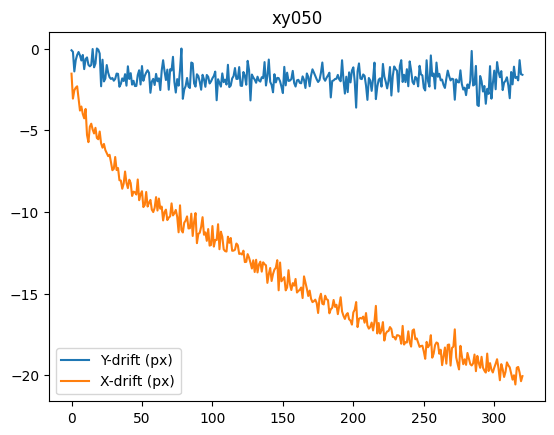

  0%|          | 0/320 [00:00<?, ?it/s]

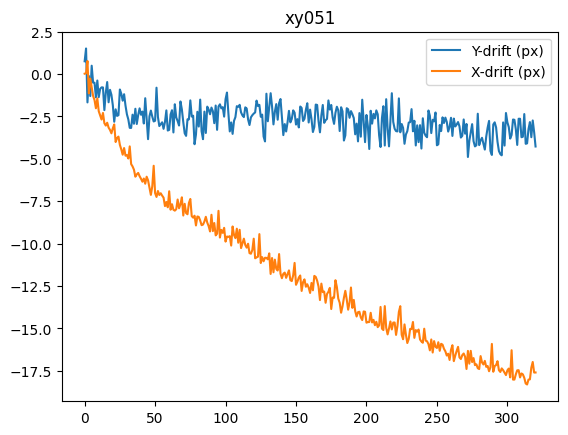

  0%|          | 0/320 [00:00<?, ?it/s]

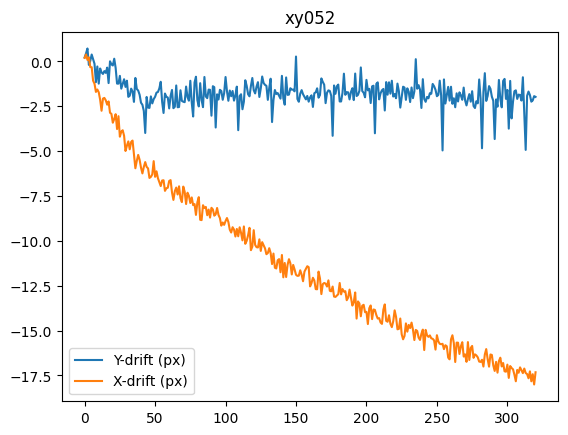

  0%|          | 0/320 [00:00<?, ?it/s]

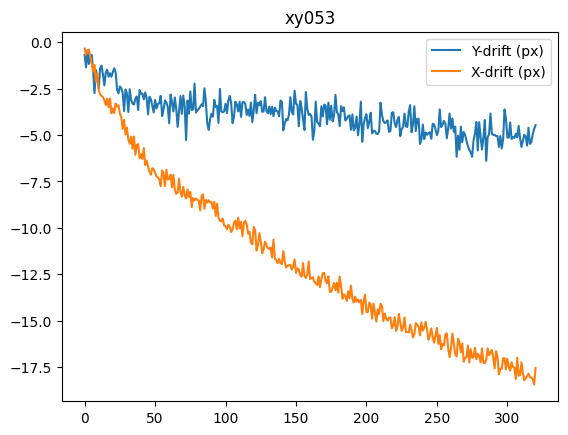

  0%|          | 0/320 [00:00<?, ?it/s]

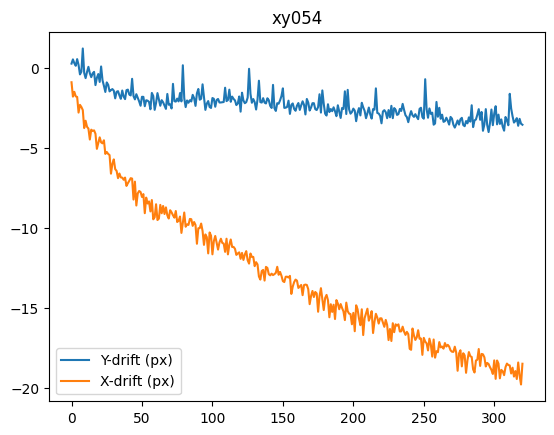

  0%|          | 0/320 [00:00<?, ?it/s]

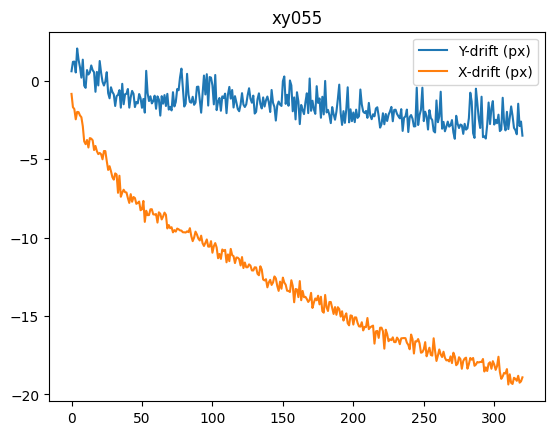

  0%|          | 0/320 [00:00<?, ?it/s]

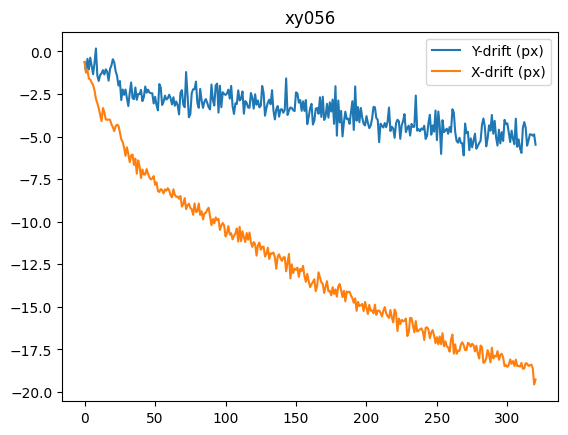

  0%|          | 0/320 [00:00<?, ?it/s]

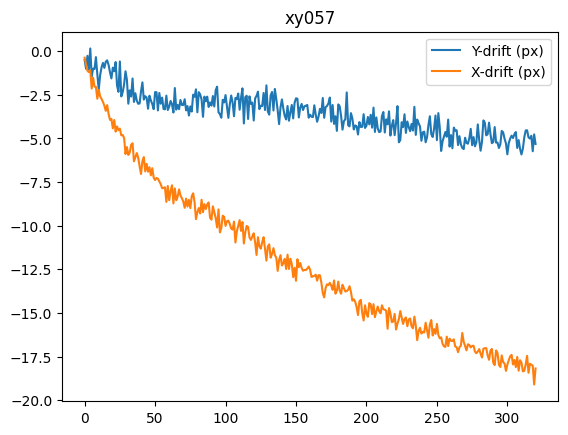

  0%|          | 0/320 [00:00<?, ?it/s]

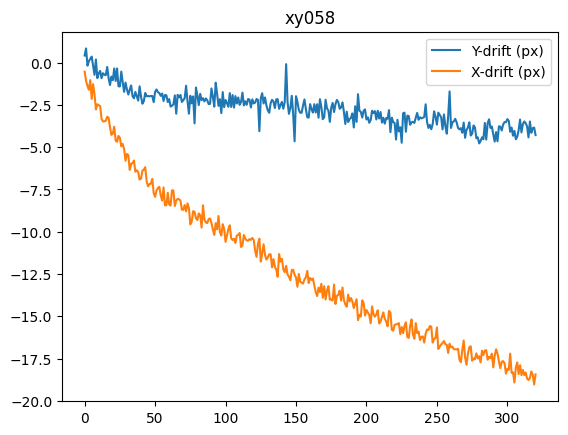

  0%|          | 0/320 [00:00<?, ?it/s]

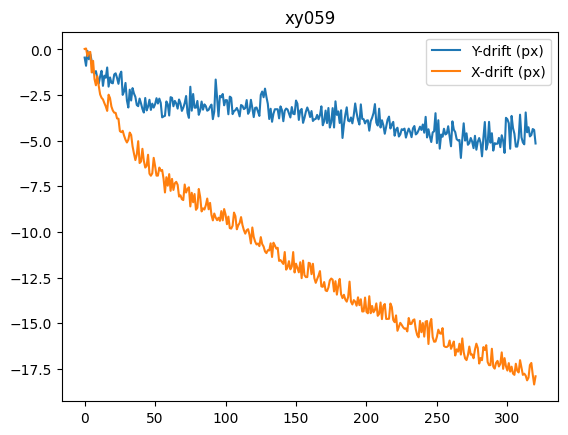

  0%|          | 0/320 [00:00<?, ?it/s]

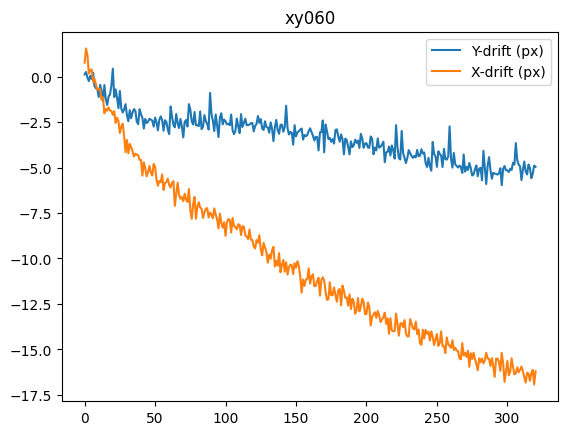

  0%|          | 0/320 [00:00<?, ?it/s]

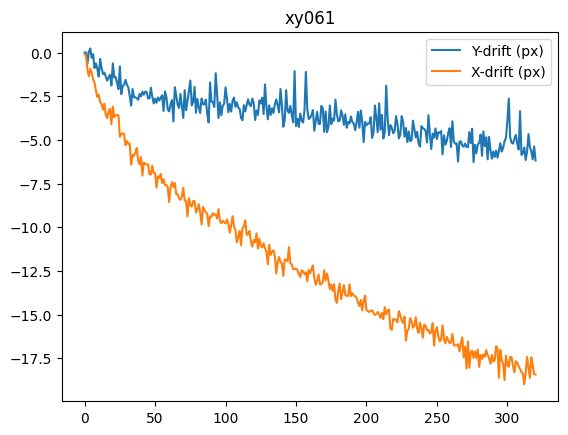

  0%|          | 0/320 [00:00<?, ?it/s]

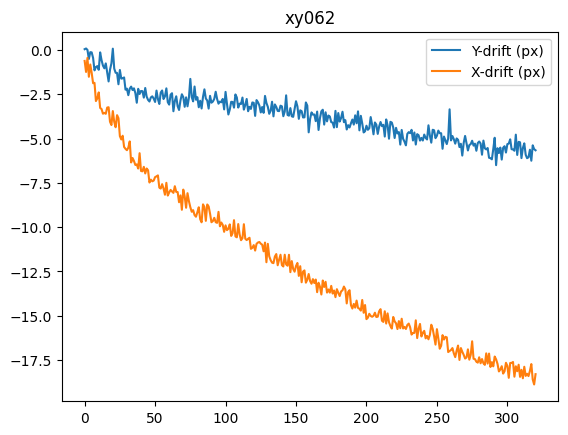

  0%|          | 0/320 [00:00<?, ?it/s]

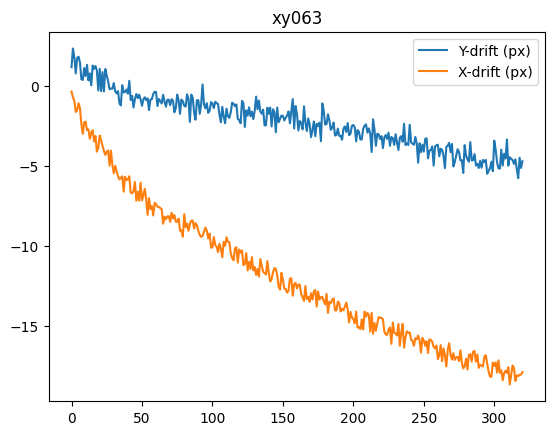

  0%|          | 0/320 [00:00<?, ?it/s]

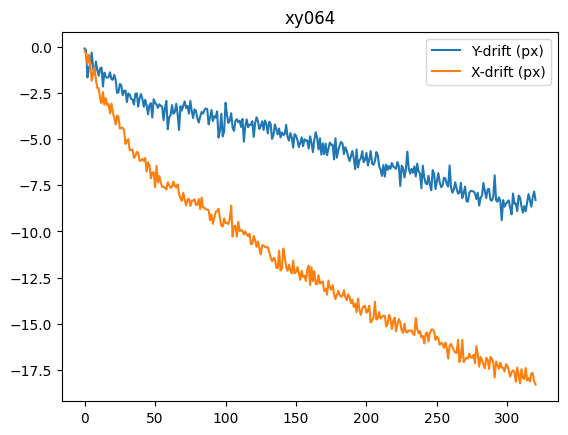

  0%|          | 0/320 [00:00<?, ?it/s]

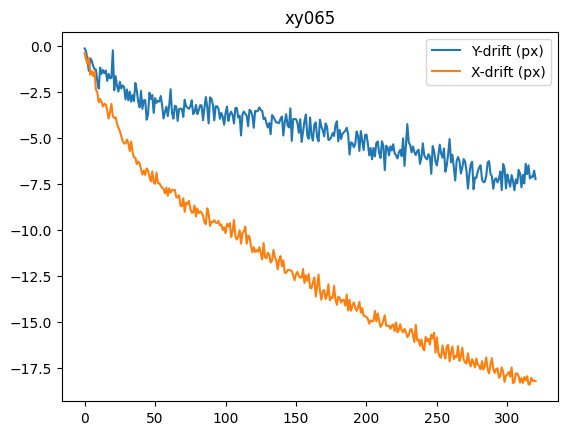

  0%|          | 0/320 [00:00<?, ?it/s]

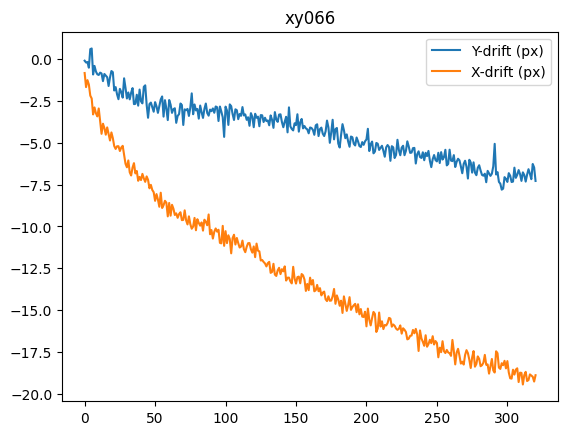

  0%|          | 0/320 [00:00<?, ?it/s]

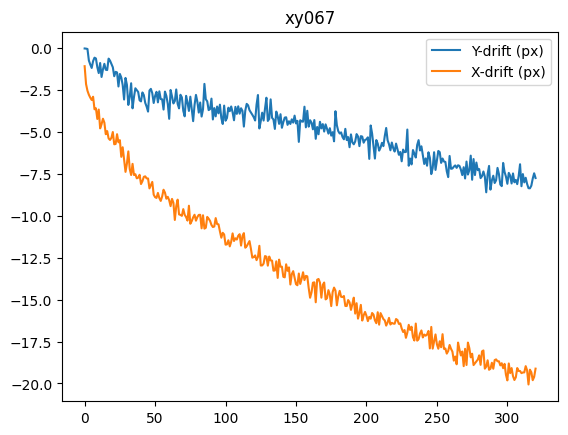

  0%|          | 0/320 [00:00<?, ?it/s]

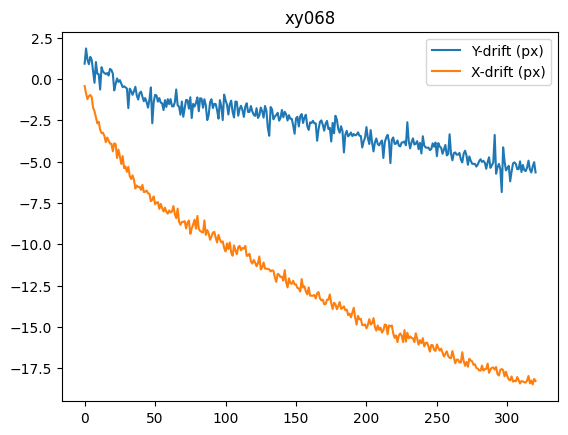

  0%|          | 0/320 [00:00<?, ?it/s]

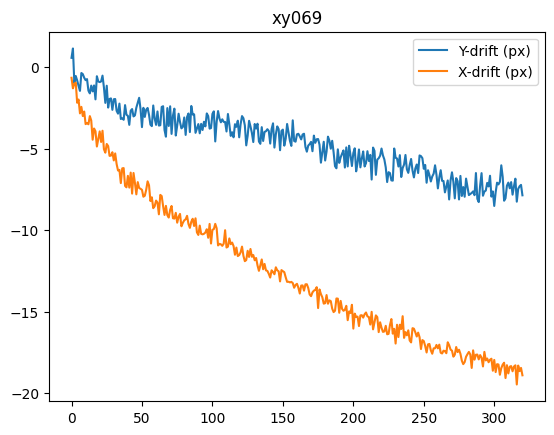

  0%|          | 0/320 [00:00<?, ?it/s]

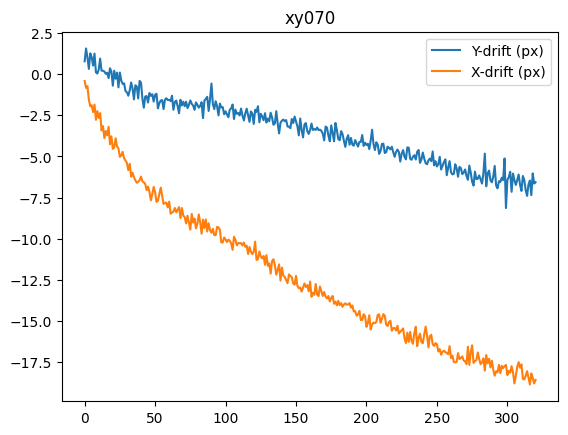

  0%|          | 0/320 [00:00<?, ?it/s]

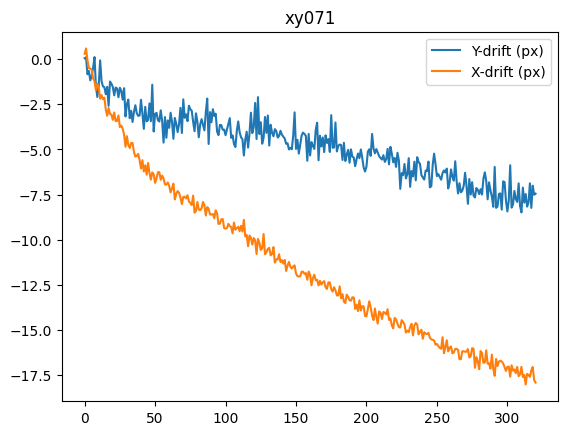

  0%|          | 0/320 [00:00<?, ?it/s]

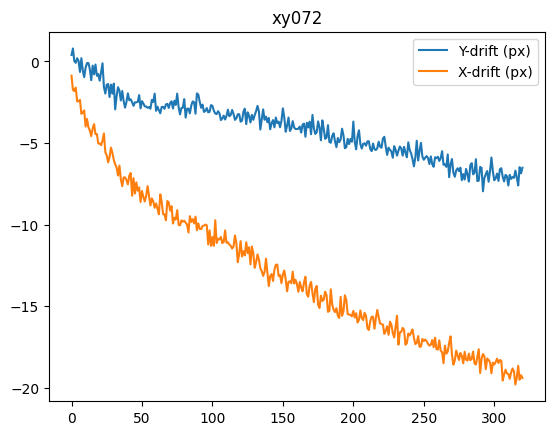

  0%|          | 0/320 [00:00<?, ?it/s]

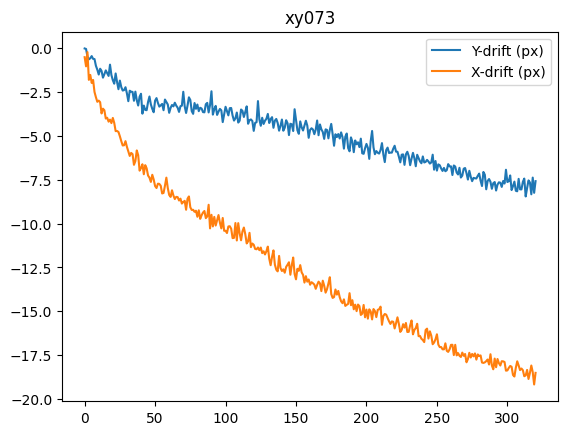

  0%|          | 0/320 [00:00<?, ?it/s]

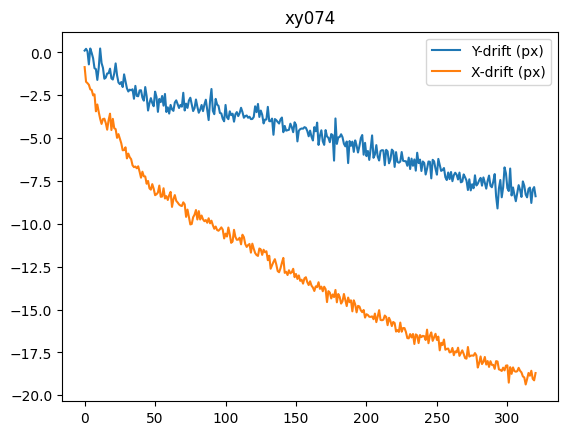

  0%|          | 0/320 [00:00<?, ?it/s]

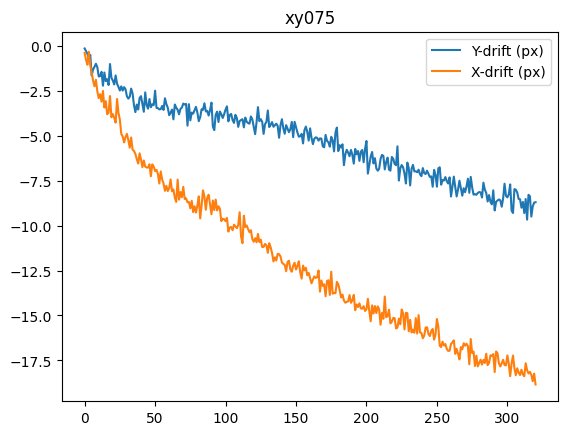

  0%|          | 0/320 [00:00<?, ?it/s]

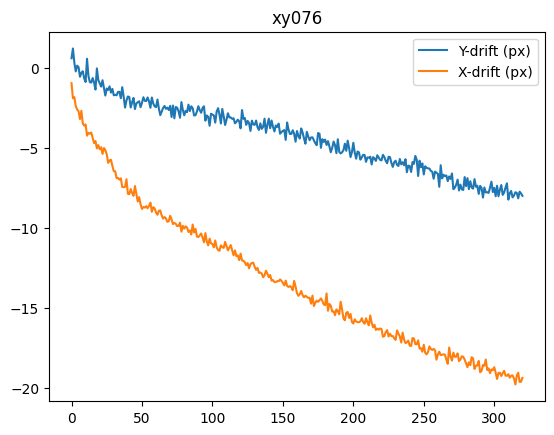

  0%|          | 0/320 [00:00<?, ?it/s]

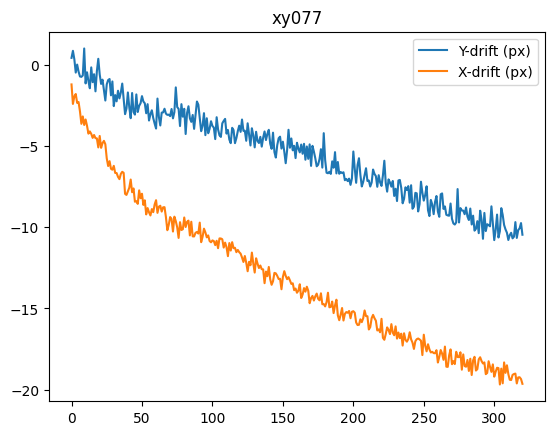

  0%|          | 0/320 [00:00<?, ?it/s]

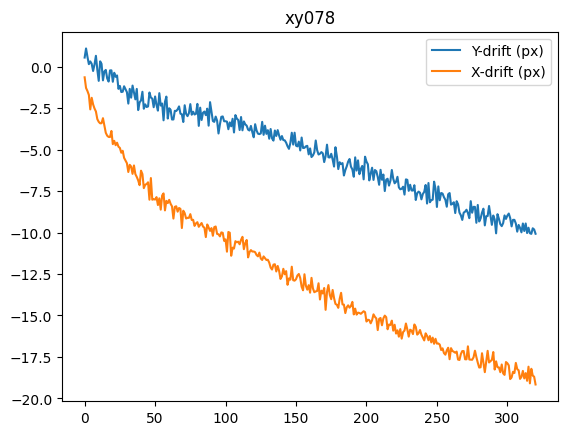

  0%|          | 0/320 [00:00<?, ?it/s]

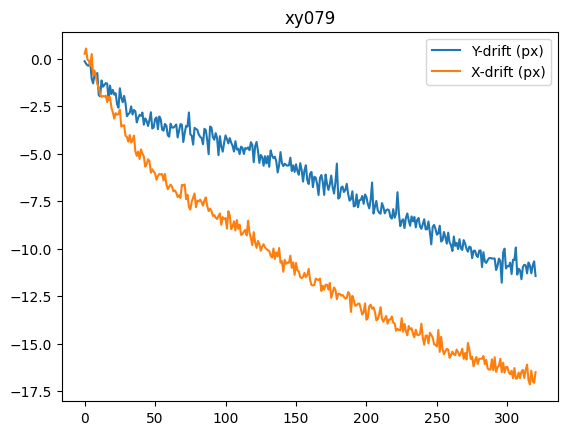

  0%|          | 0/320 [00:00<?, ?it/s]

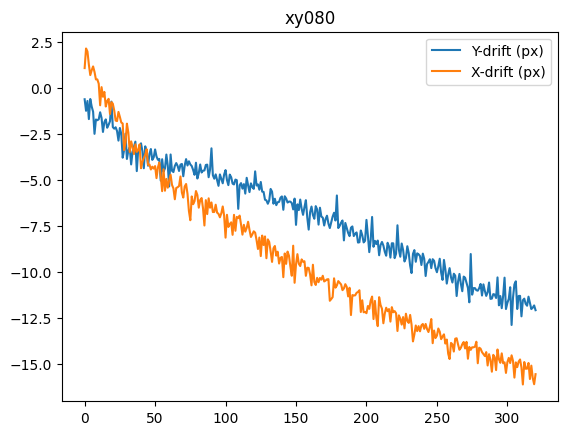

  0%|          | 0/320 [00:00<?, ?it/s]

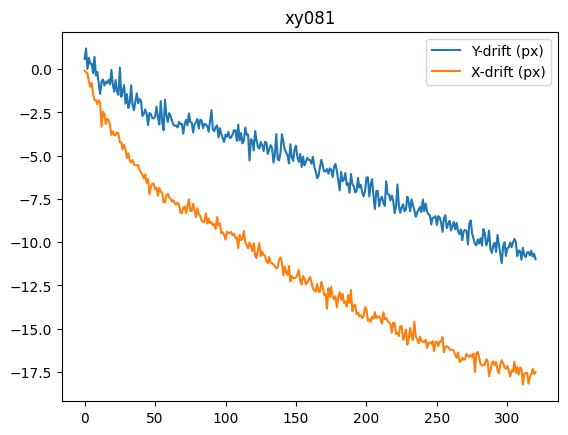

  0%|          | 0/320 [00:00<?, ?it/s]

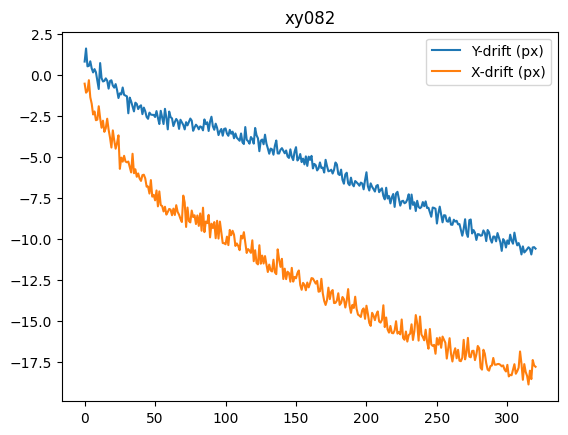

  0%|          | 0/320 [00:00<?, ?it/s]

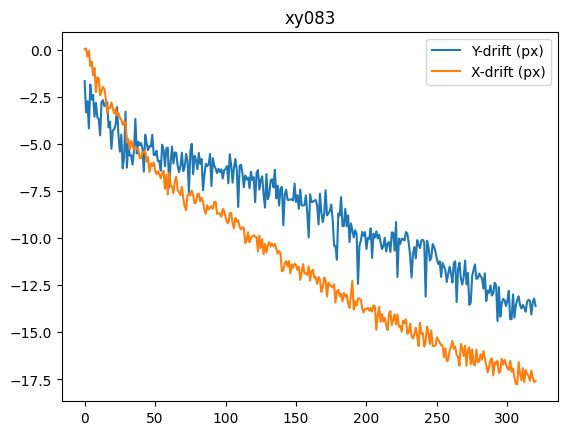

  0%|          | 0/320 [00:00<?, ?it/s]

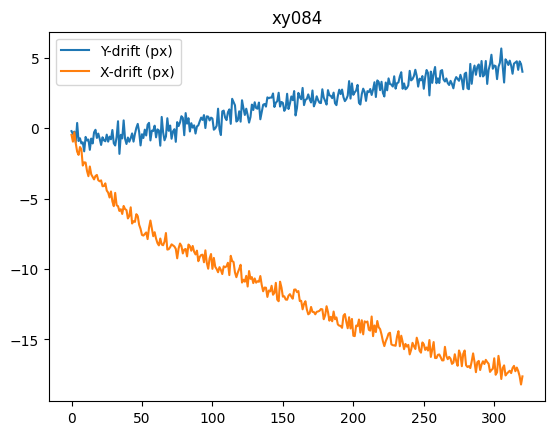

  0%|          | 0/320 [00:00<?, ?it/s]

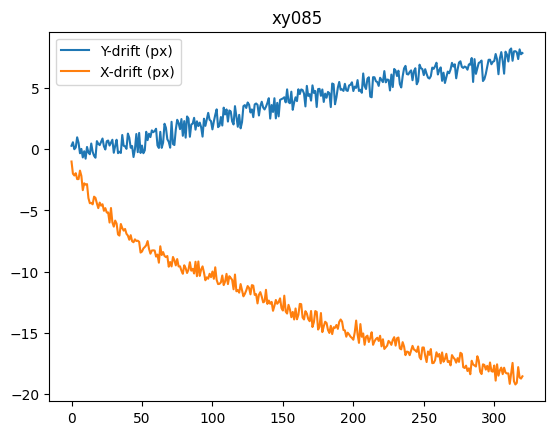

  0%|          | 0/320 [00:00<?, ?it/s]

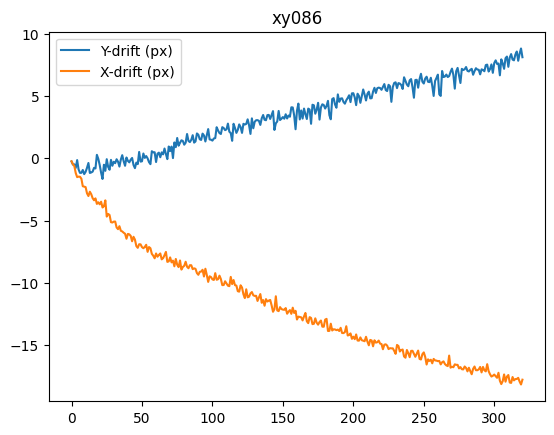

  0%|          | 0/320 [00:00<?, ?it/s]

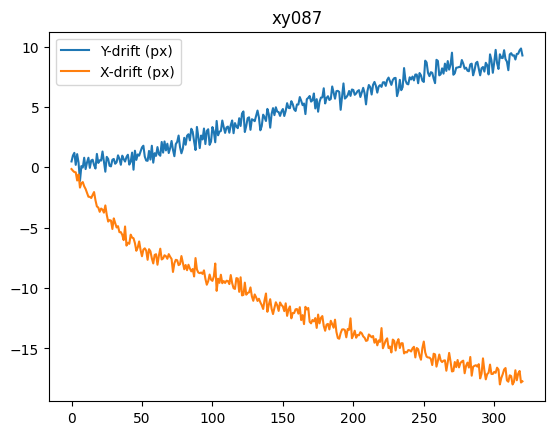

  0%|          | 0/320 [00:00<?, ?it/s]

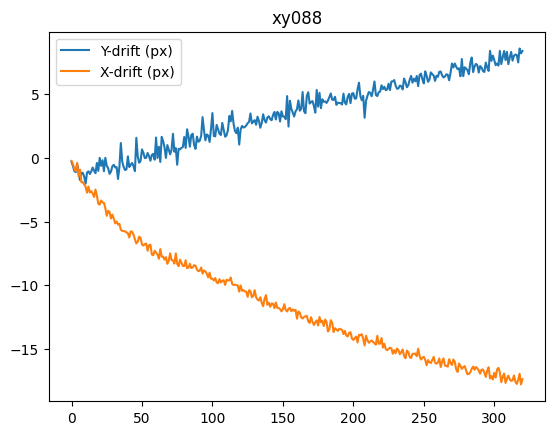

  0%|          | 0/320 [00:00<?, ?it/s]

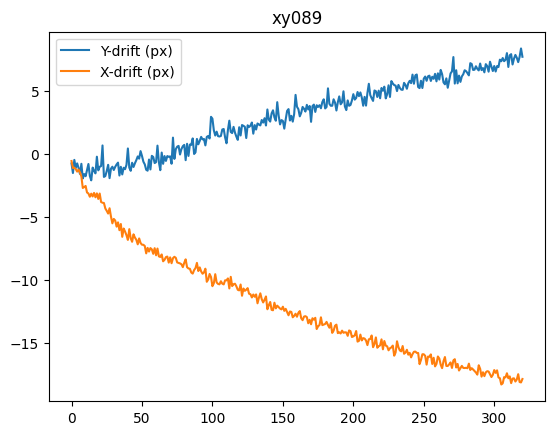

  0%|          | 0/320 [00:00<?, ?it/s]

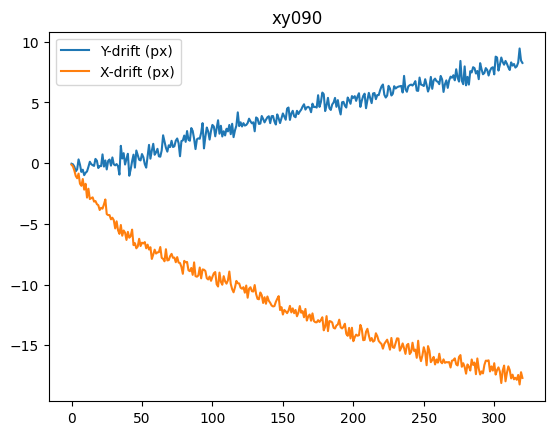

  0%|          | 0/320 [00:00<?, ?it/s]

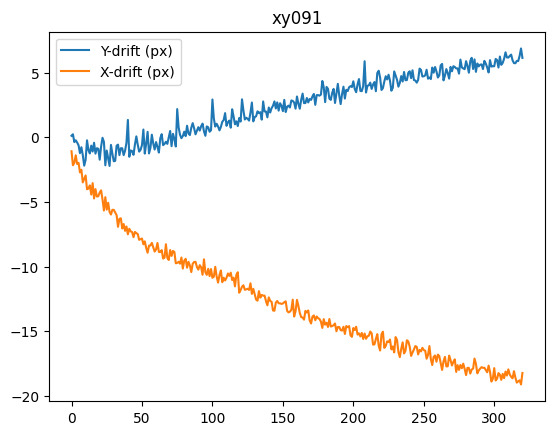

  0%|          | 0/320 [00:00<?, ?it/s]

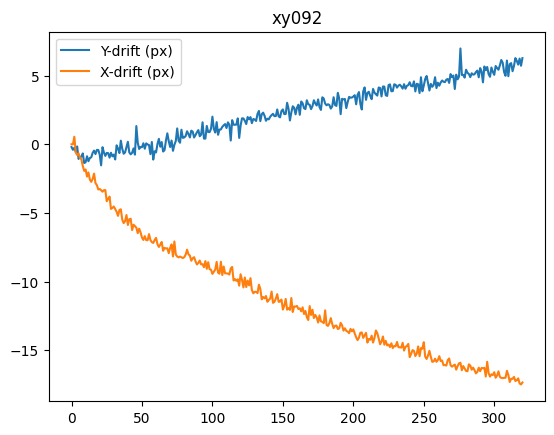

  0%|          | 0/320 [00:00<?, ?it/s]

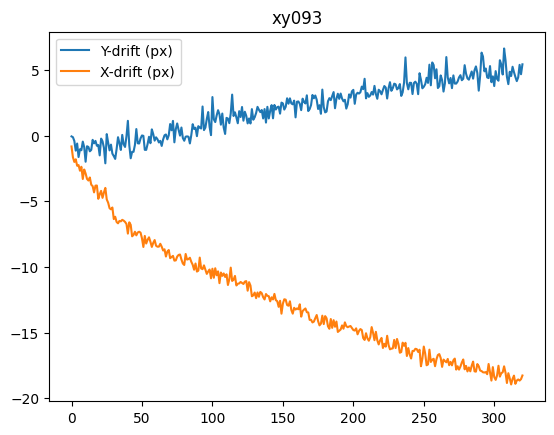

  0%|          | 0/320 [00:00<?, ?it/s]

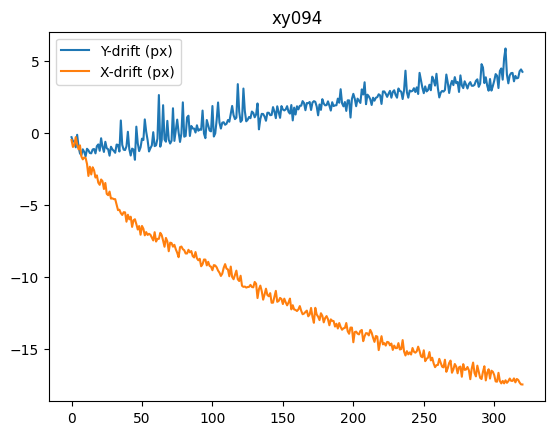

  0%|          | 0/320 [00:00<?, ?it/s]

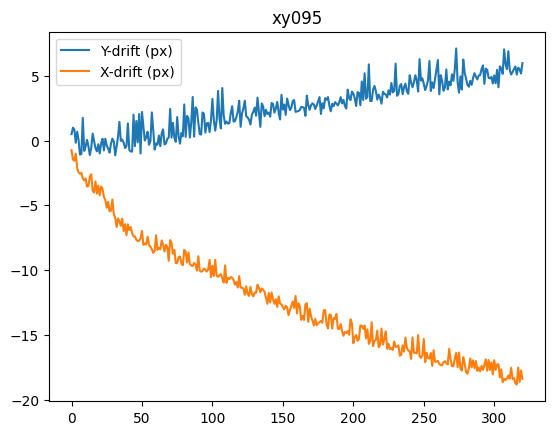

  0%|          | 0/320 [00:00<?, ?it/s]

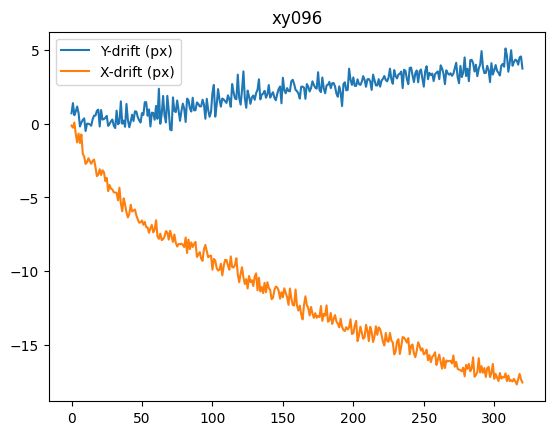

  0%|          | 0/320 [00:00<?, ?it/s]

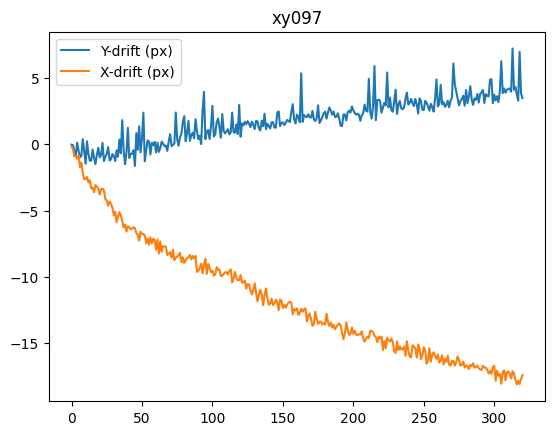

  0%|          | 0/320 [00:00<?, ?it/s]

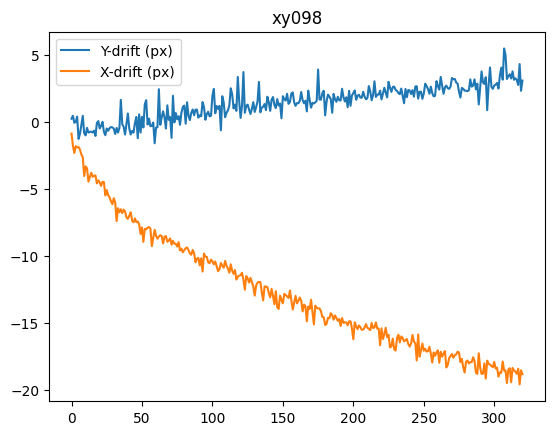

  0%|          | 0/320 [00:00<?, ?it/s]

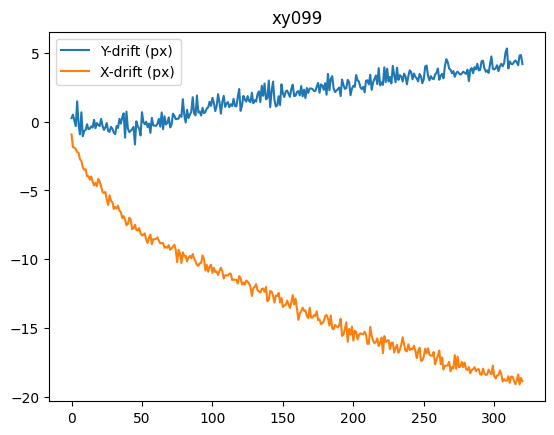

  0%|          | 0/320 [00:00<?, ?it/s]

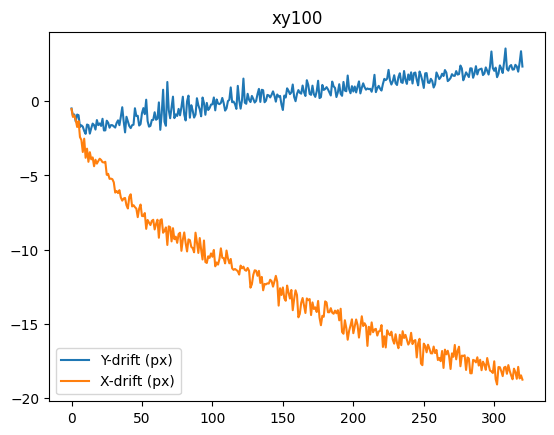

  0%|          | 0/320 [00:00<?, ?it/s]

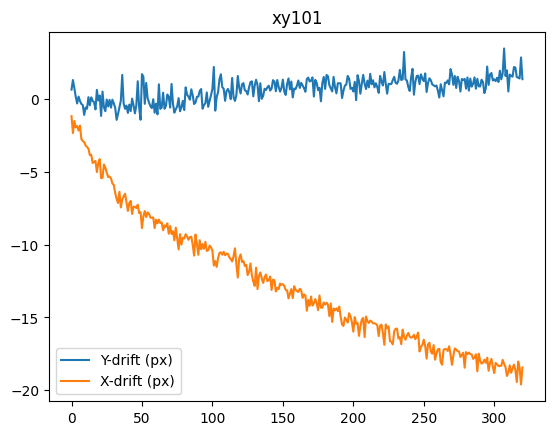

  0%|          | 0/320 [00:00<?, ?it/s]

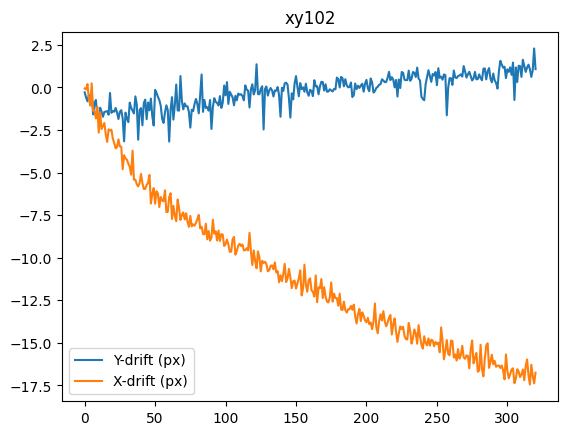

  0%|          | 0/320 [00:00<?, ?it/s]

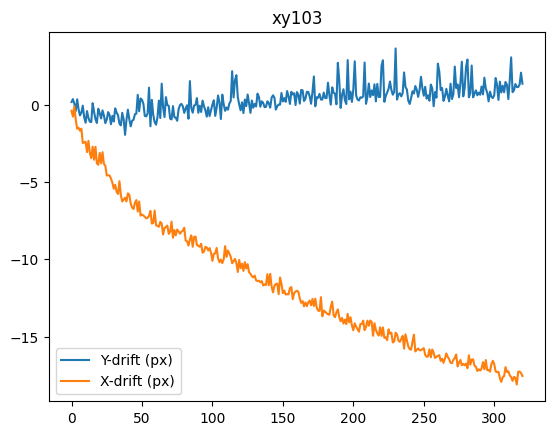

  0%|          | 0/320 [00:00<?, ?it/s]

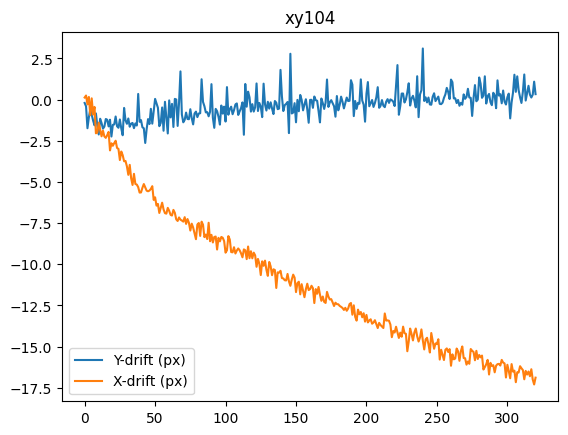

  0%|          | 0/320 [00:00<?, ?it/s]

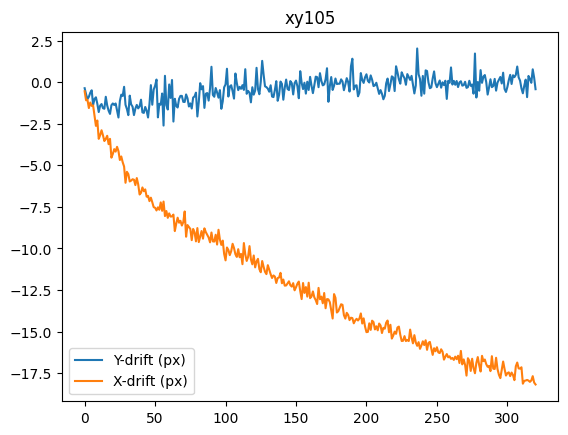

  0%|          | 0/320 [00:00<?, ?it/s]

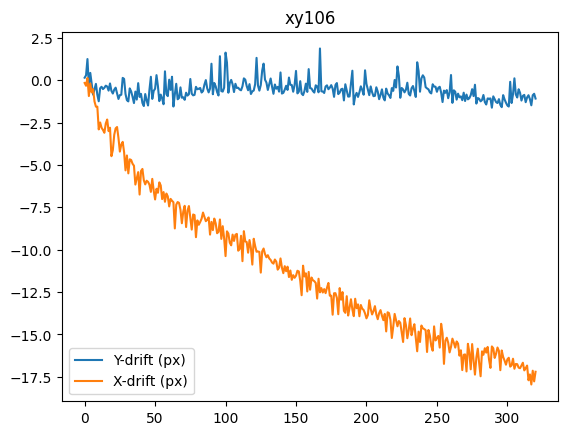

  0%|          | 0/320 [00:00<?, ?it/s]

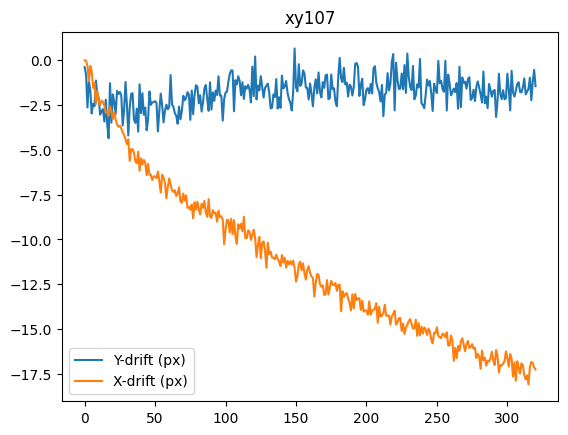

  0%|          | 0/320 [00:00<?, ?it/s]

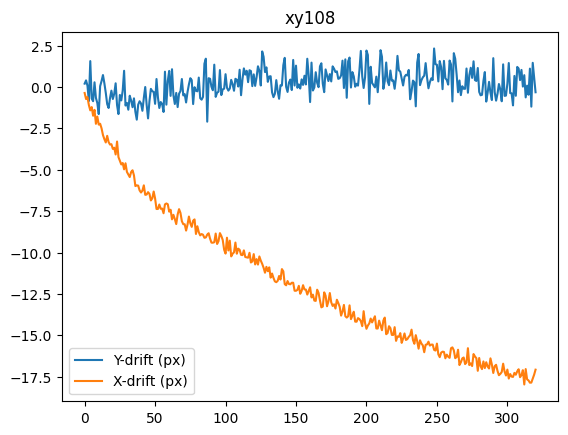

  0%|          | 0/320 [00:00<?, ?it/s]

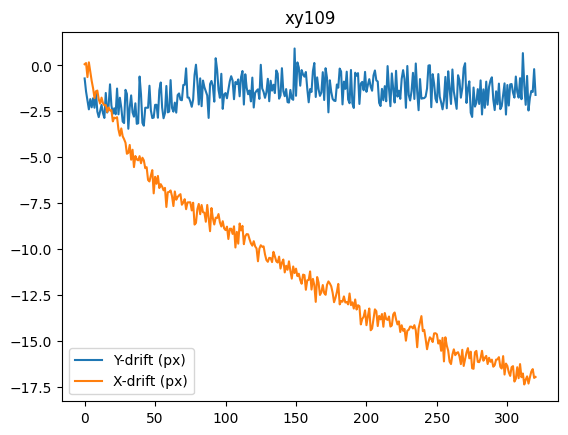

  0%|          | 0/320 [00:00<?, ?it/s]

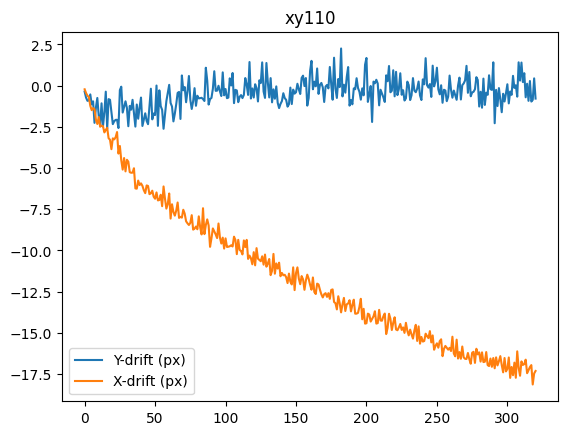

  0%|          | 0/320 [00:00<?, ?it/s]

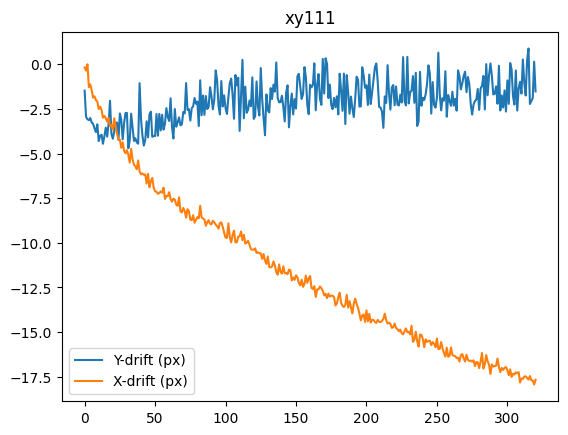

  0%|          | 0/320 [00:00<?, ?it/s]

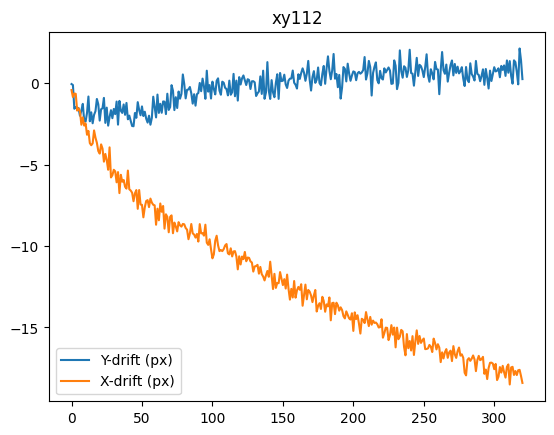

  0%|          | 0/320 [00:00<?, ?it/s]

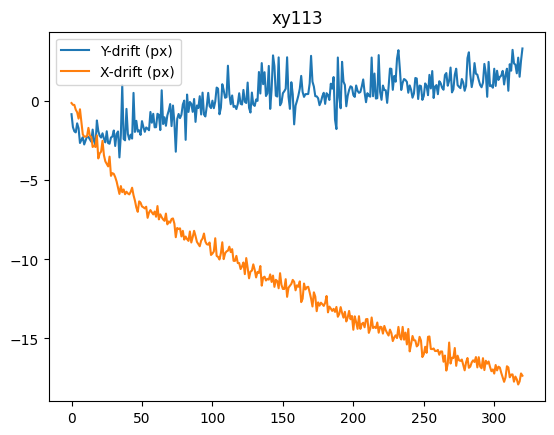

  0%|          | 0/320 [00:00<?, ?it/s]

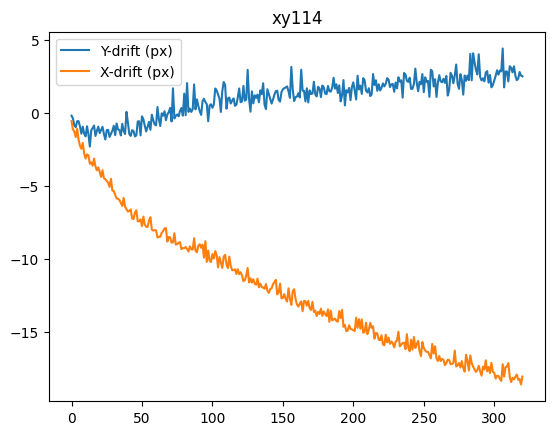

  0%|          | 0/320 [00:00<?, ?it/s]

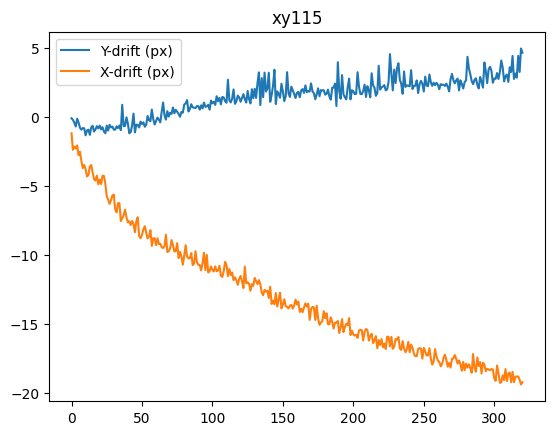

  0%|          | 0/320 [00:00<?, ?it/s]

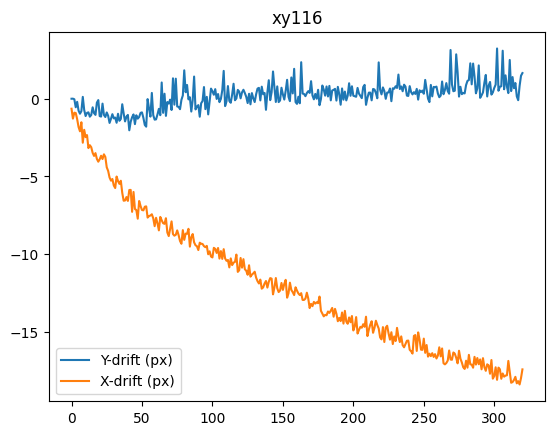

  0%|          | 0/320 [00:00<?, ?it/s]

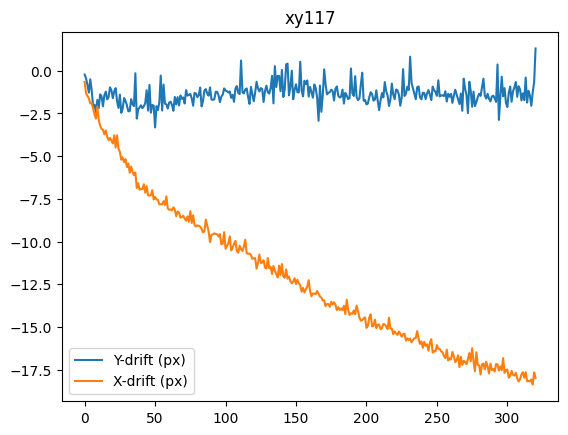

  0%|          | 0/320 [00:00<?, ?it/s]

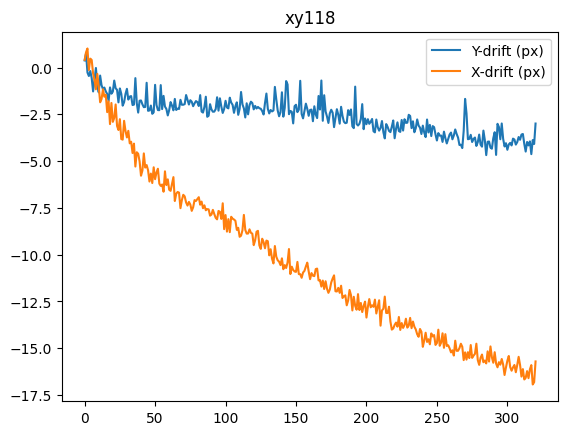

  0%|          | 0/320 [00:00<?, ?it/s]

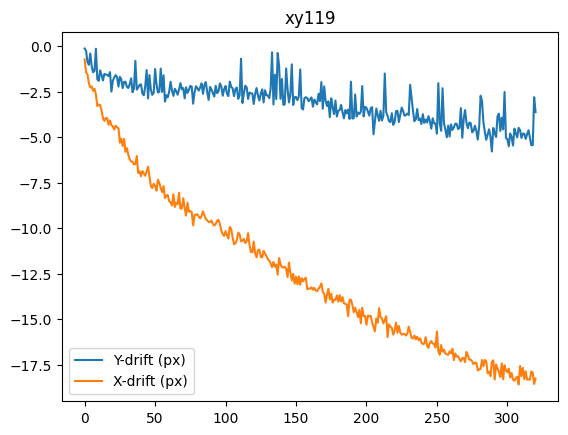

  0%|          | 0/320 [00:00<?, ?it/s]

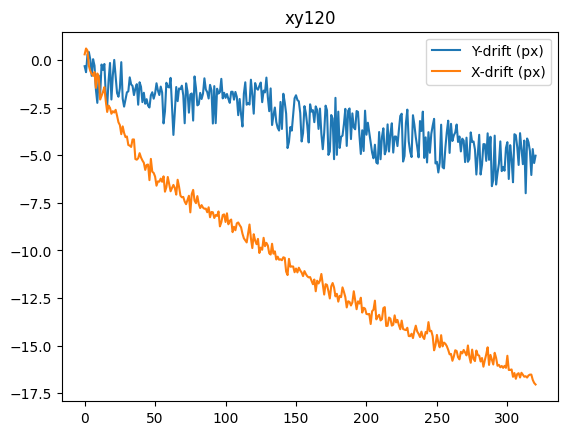

  0%|          | 0/320 [00:00<?, ?it/s]

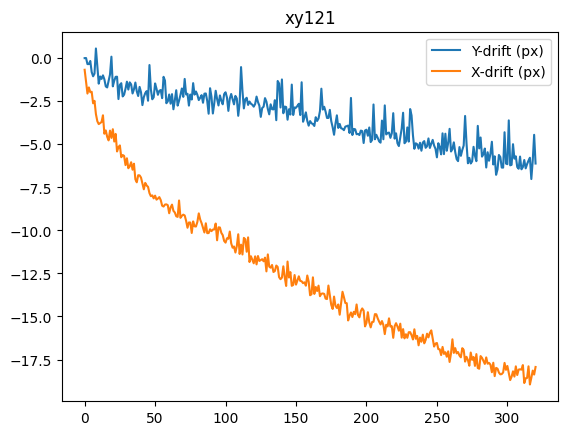

  0%|          | 0/320 [00:00<?, ?it/s]

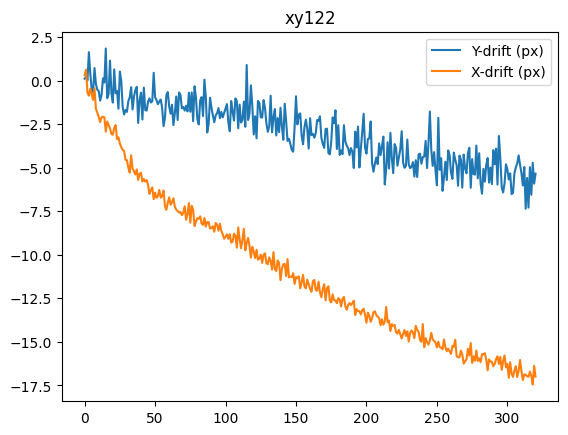

  0%|          | 0/320 [00:00<?, ?it/s]

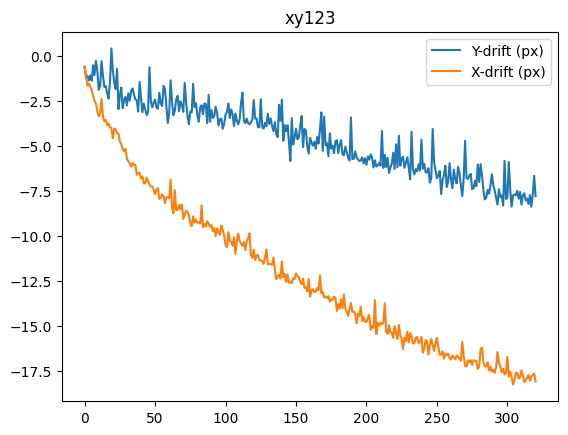

  0%|          | 0/320 [00:00<?, ?it/s]

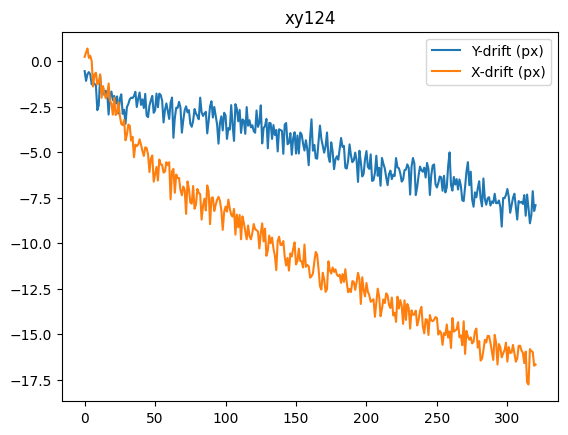

  0%|          | 0/320 [00:00<?, ?it/s]

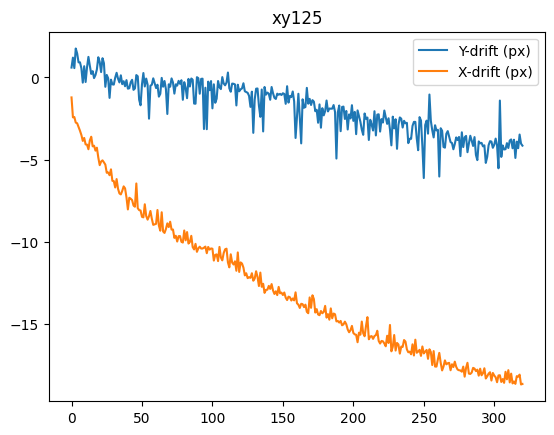

  0%|          | 0/320 [00:00<?, ?it/s]

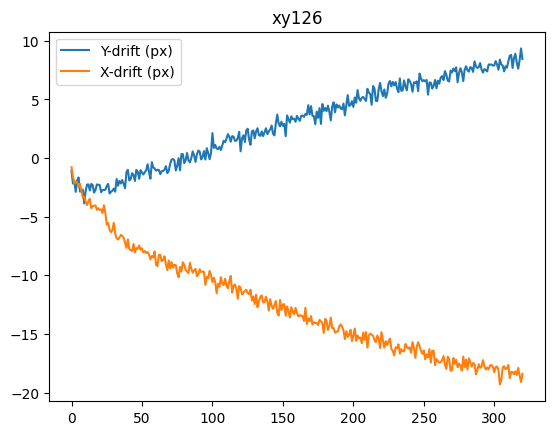

  0%|          | 0/320 [00:00<?, ?it/s]

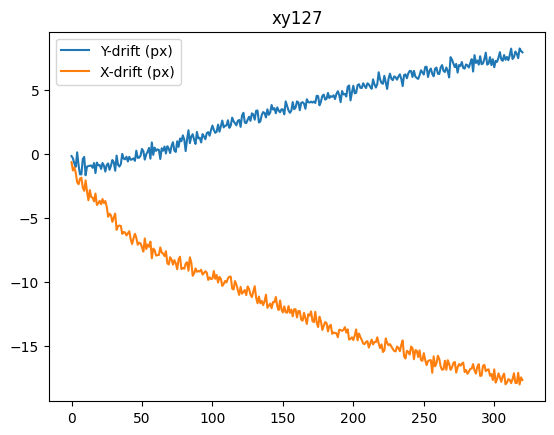

  0%|          | 0/320 [00:00<?, ?it/s]

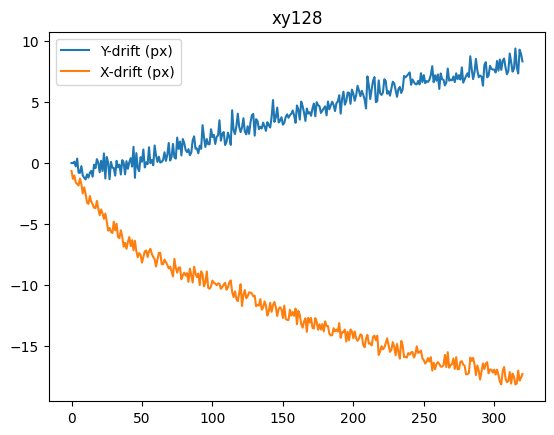

  0%|          | 0/320 [00:00<?, ?it/s]

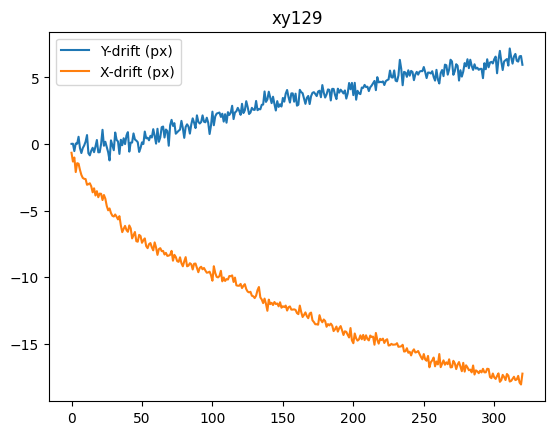

  0%|          | 0/320 [00:00<?, ?it/s]

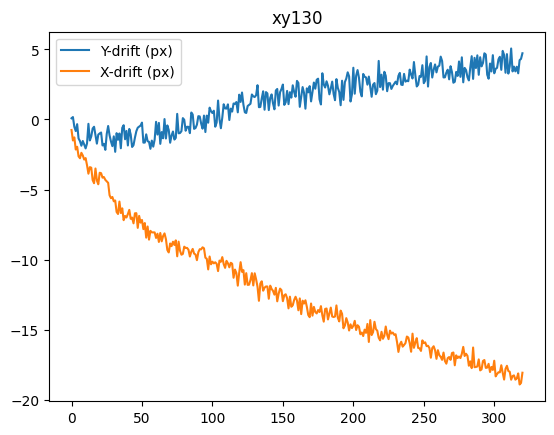

  0%|          | 0/320 [00:00<?, ?it/s]

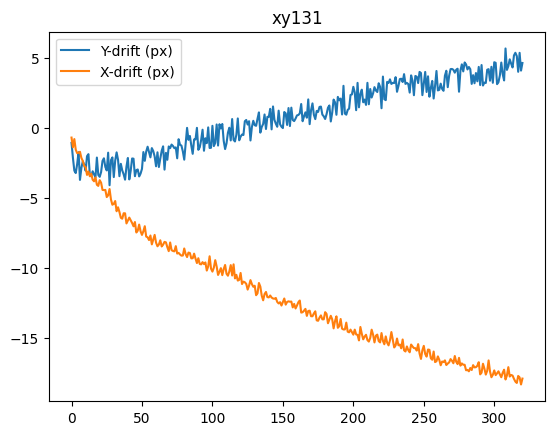

  0%|          | 0/320 [00:00<?, ?it/s]

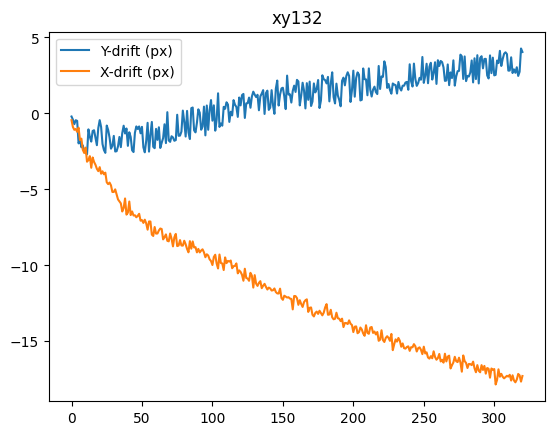

  0%|          | 0/320 [00:00<?, ?it/s]

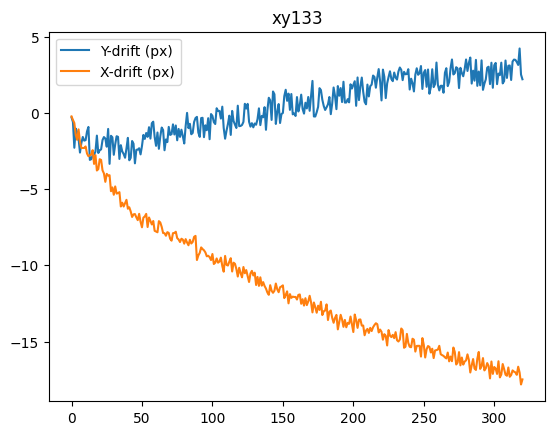

  0%|          | 0/320 [00:00<?, ?it/s]

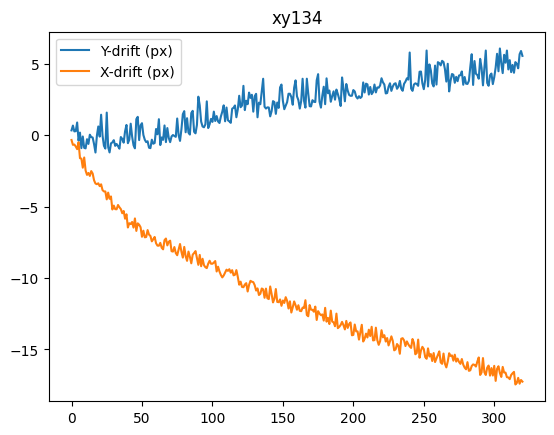

  0%|          | 0/320 [00:00<?, ?it/s]

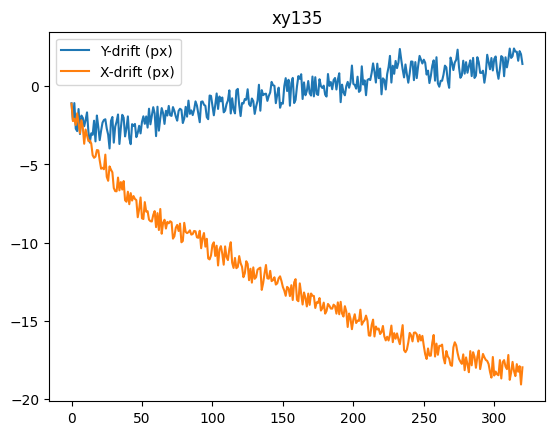

  0%|          | 0/320 [00:00<?, ?it/s]

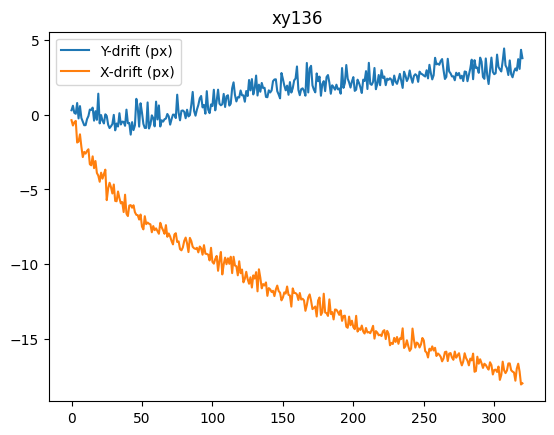

  0%|          | 0/320 [00:00<?, ?it/s]

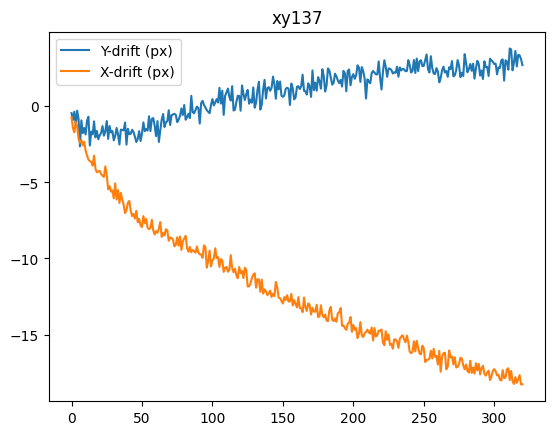

  0%|          | 0/320 [00:00<?, ?it/s]

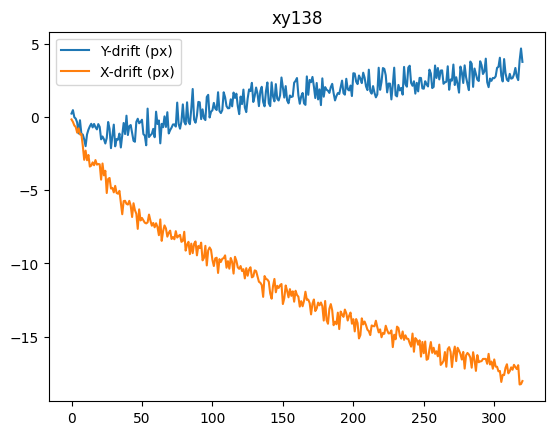

  0%|          | 0/320 [00:00<?, ?it/s]

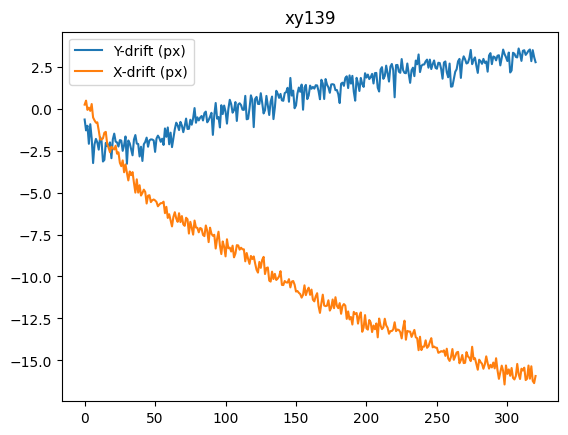

  0%|          | 0/320 [00:00<?, ?it/s]

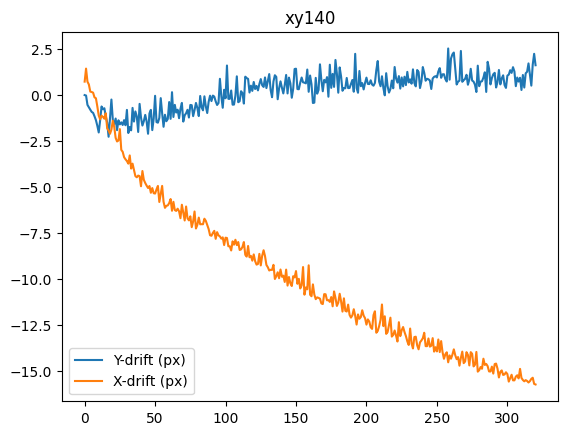

  0%|          | 0/320 [00:00<?, ?it/s]

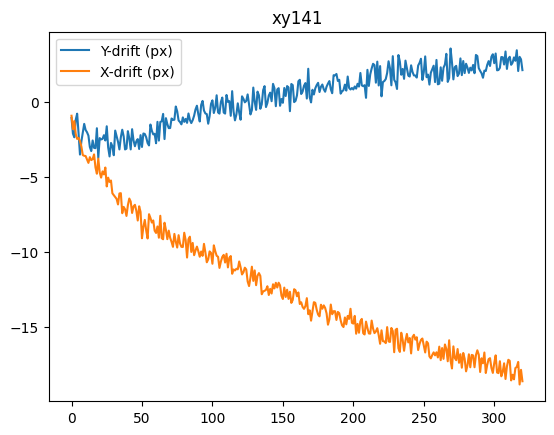

  0%|          | 0/320 [00:00<?, ?it/s]

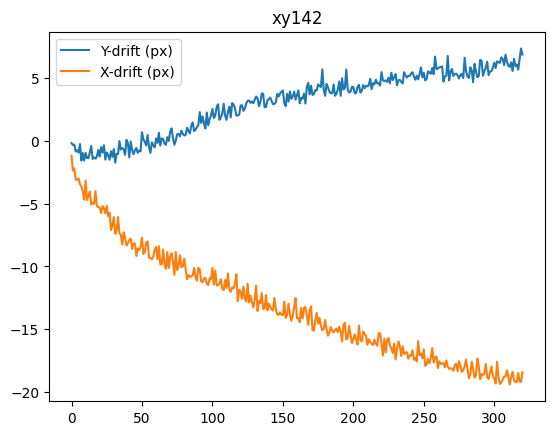

  0%|          | 0/320 [00:00<?, ?it/s]

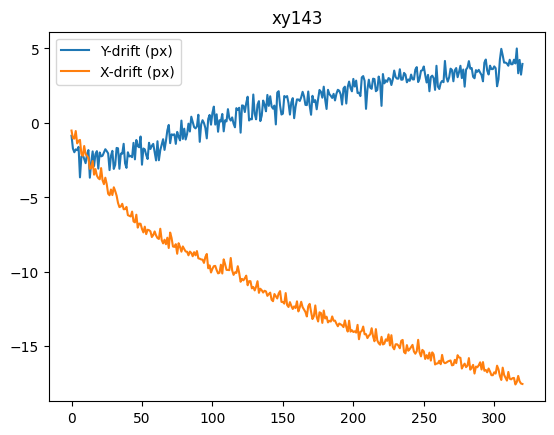

  0%|          | 0/320 [00:00<?, ?it/s]

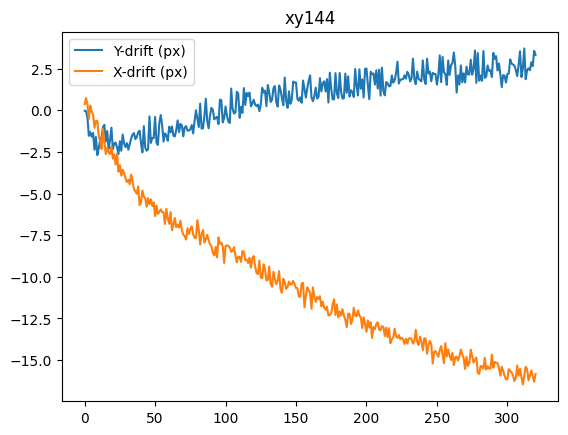

  0%|          | 0/320 [00:00<?, ?it/s]

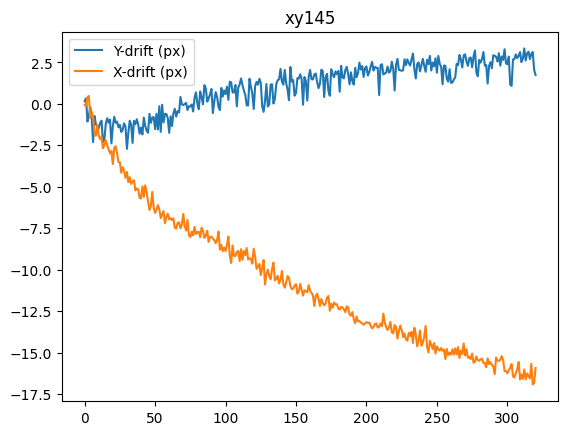

  0%|          | 0/320 [00:00<?, ?it/s]

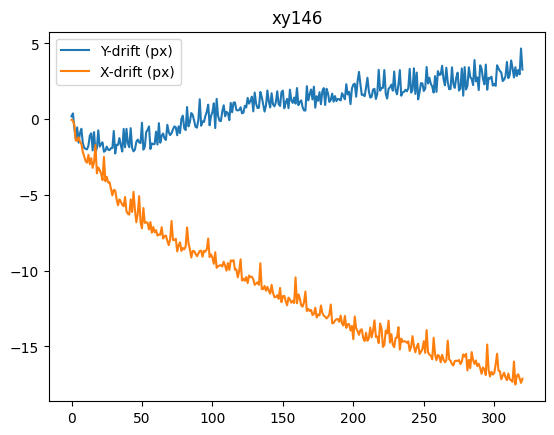

  0%|          | 0/320 [00:00<?, ?it/s]

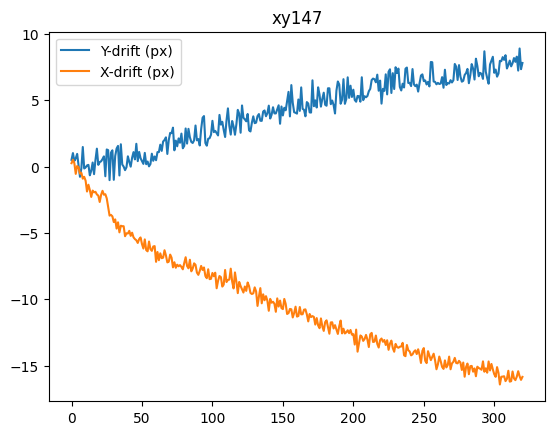

  0%|          | 0/320 [00:00<?, ?it/s]

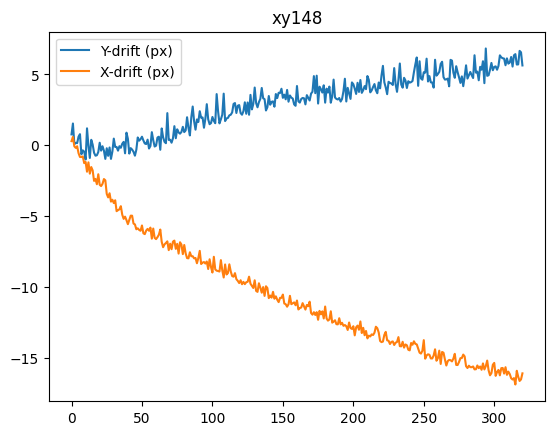

  0%|          | 0/320 [00:00<?, ?it/s]

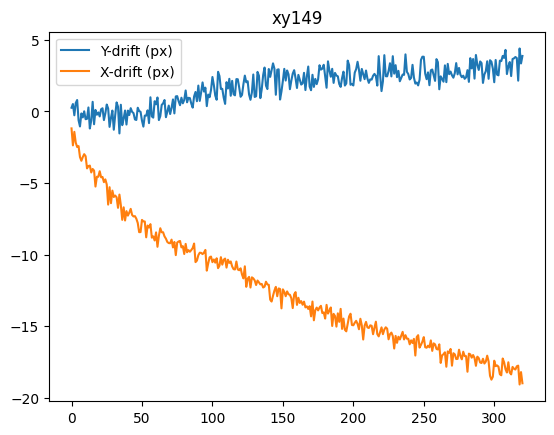

  0%|          | 0/320 [00:00<?, ?it/s]

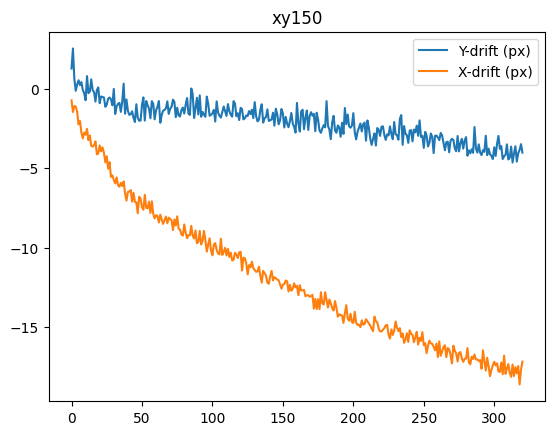

  0%|          | 0/320 [00:00<?, ?it/s]

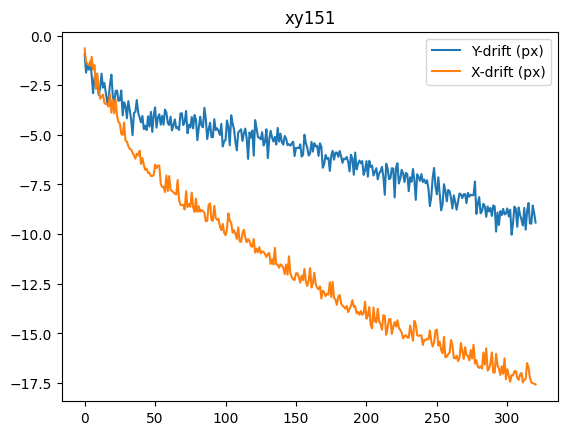

  0%|          | 0/320 [00:00<?, ?it/s]

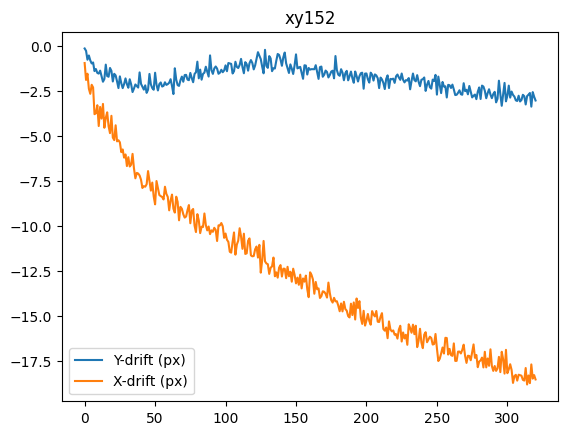

  0%|          | 0/320 [00:00<?, ?it/s]

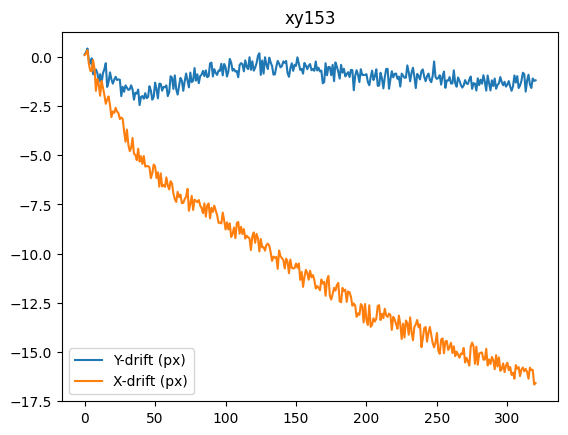

  0%|          | 0/320 [00:00<?, ?it/s]

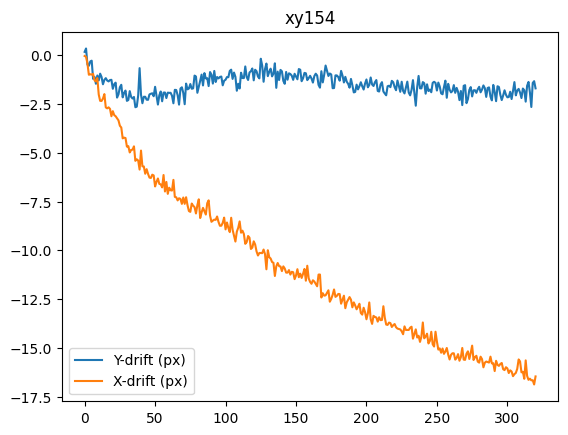

  0%|          | 0/320 [00:00<?, ?it/s]

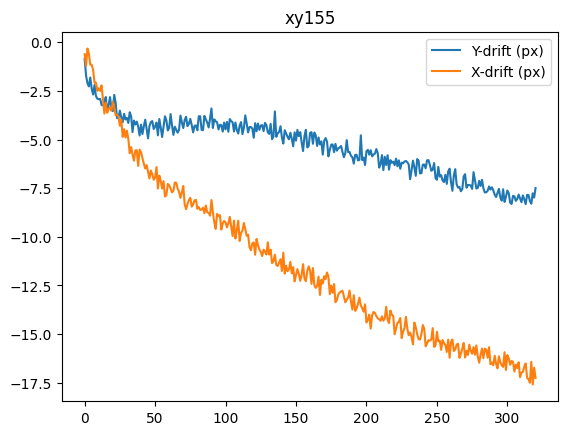

  0%|          | 0/320 [00:00<?, ?it/s]

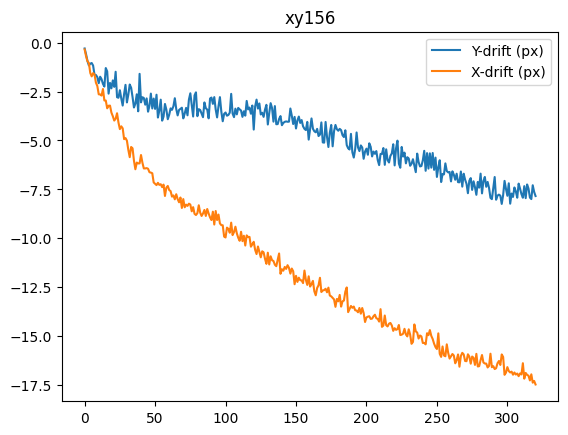

  0%|          | 0/320 [00:00<?, ?it/s]

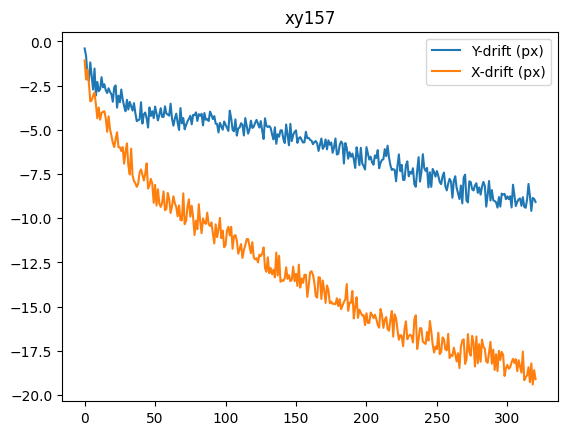

  0%|          | 0/320 [00:00<?, ?it/s]

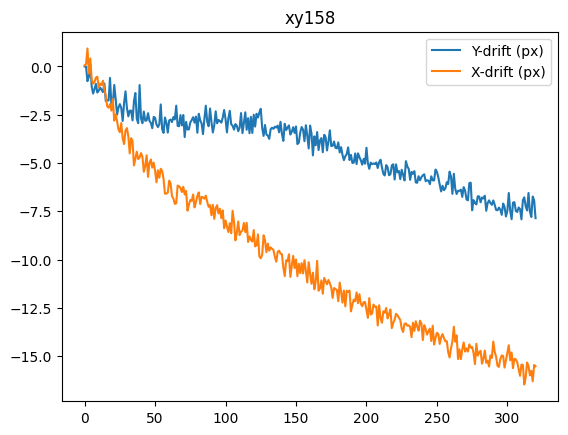

In [20]:
my_experiment.register_experiment(
    force=True,
    mode="previous",
    n_jobs = 20, 
    y_lims = (0,-1),
    x_lims = (0,-1),
    plot=True,
    remove_extracted=False # Modified to delete extracted image after creating registered image (to save space for large experiments)
)

In [21]:
# Use this cell to discard FOVs with bad registration 
discard_FOVs = []
discard_FOVs = [f"xy0{str(x).zfill(2)}" for x in discard_FOVs]
my_experiment.discard_FOVs(discard_FOVs)
my_experiment.FOVs

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


In [22]:
## SPLIT FOVs INTO SEPERATE TRENCH ROWS

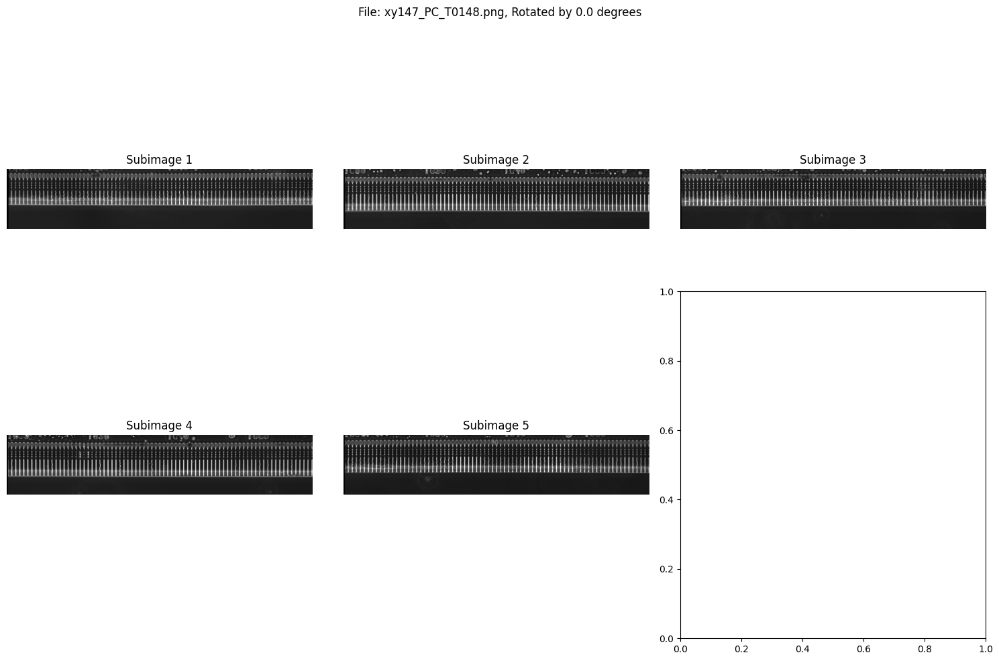

In [10]:
# Testing - 5 trench lanes per FOV (backport chip, 40x)
# Define the directories
directory = directory
input_directory = f"{directory}/registered"

# Define the crop parameters
crop_top = 50  # pixels
crop_bottom = 0  # pixels
flip_odd = False  # If True, flip odd subimages; if False, flip even subimages

# Function to visualize the cropping and flipping of images
def visualize_crop(input_directory, rotate_angle=0.0):
    # Get a list of all PNG files in the directory
    image_files = [f for f in os.listdir(input_directory) if f.endswith('.png')]

    # Regular expression pattern to extract FOV number
    pattern = re.compile(r'xy(\d+)_(.+)_T(\d+)\.png')

    # Find one image to demonstrate
    image_file = image_files[0] if image_files else None

    if image_file:
        # Load image and extract dimensions
        img = Image.open(os.path.join(input_directory, image_file))
        width, height = img.size

        # Rotate the image if rotate_angle is not zero
        if rotate_angle != 0.0:
            img_array = np.array(img)
            rotated_image = transform.rotate(img_array, angle=rotate_angle, preserve_range=True).astype(np.uint16)
            img = Image.fromarray(rotated_image)
            width, height = img.size

        # Adjust the height by cropping out top and bottom pixels
        effective_height = height - crop_top - crop_bottom

        # Define the crop areas
        num_lanes = 5
        subimage_height = effective_height // num_lanes
        crop_areas = [
            (0, crop_top + i * subimage_height, width, crop_top + (i + 1) * subimage_height)
            for i in range(num_lanes)
        ]

        # Crop the images
        subimages = [img.crop(area) for area in crop_areas]

        # Flip the subimages based on the flip_odd flag
        for idx in range(len(subimages)):
            # subimage_num is 1-based
            subimage_num = idx + 1
            if flip_odd and (subimage_num % 2 == 1):
                # Flip odd-numbered subimages
                subimages[idx] = subimages[idx].transpose(Image.FLIP_TOP_BOTTOM)
            elif not flip_odd and (subimage_num % 2 == 0):
                # Flip even-numbered subimages
                subimages[idx] = subimages[idx].transpose(Image.FLIP_TOP_BOTTOM)

        # Visualize the subimages
        fig, ax = plt.subplots(2, 3, figsize=(15, 10))  # Adjusted for 2 rows and 3 columns
        ax = ax.flatten()  # Flatten the axes array for easy indexing
        for i, subimg in enumerate(subimages):
            ax[i].imshow(subimg, cmap='gray')
            ax[i].set_title(f"Subimage {i+1}")
            ax[i].axis('off')  # Hide axis for better visualization
        plt.suptitle(f"File: {image_file}, Rotated by {rotate_angle} degrees")
        plt.tight_layout()
        plt.show()
    else:
        print("No PNG files found in the directory.")

# Run the visualization function
visualize_crop(input_directory, rotate_angle=0.0)

In [11]:
# Running - 5 trench lanes per FOV (backport chip, 40x)
# Version that should be robust to stopping and restarting (but need to confirm this)
# Define the directories
directory = directory
input_directory = f"{directory}/registered"
output_directory = f"{directory}/registered_split"
delete_original = False  # Change to True to delete original files after processing

# Take the crop parameters from above testing chunk
crop_top = crop_top
crop_bottom = crop_bottom
flip_odd = flip_odd
num_lanes = 5       # Number of subimages per original image

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Regular expression pattern to extract FOV, marker, and timepoint
pattern = re.compile(r'xy(\d+)_(.+)_T(\d+)\.png')

def process_image(image_file, input_directory, output_directory, delete_original, num_lanes):
    match = pattern.match(image_file)
    if not match:
        return

    original_fov = match.group(1)
    marker = match.group(2)
    timepoint = match.group(3)
    
    # Calculate a base value for the new FOV numbers
    new_fov_base = int(original_fov) * num_lanes

    # Determine expected output file paths for this input image
    expected_files = [
        os.path.join(output_directory, f"xy{str(new_fov_base + i).zfill(3)}_{marker}_T{timepoint}.png")
        for i in range(num_lanes)
    ]
    # Skip processing if all expected files already exist
    if all(os.path.exists(f) for f in expected_files):
        print(f"Skipping {image_file} (already processed).")
        return

    img_path = os.path.join(input_directory, image_file)
    try:
        img = Image.open(img_path)
    except Exception as e:
        print(f"Error opening {img_path}: {e}")
        return

    width, height = img.size
    effective_height = height - crop_top - crop_bottom
    subimage_height = effective_height // num_lanes

    # Define crop areas for each lane
    crop_areas = [
        (0, crop_top + i * subimage_height, width, crop_top + (i + 1) * subimage_height)
        for i in range(num_lanes)
    ]

    # Crop out the lanes
    subimages = [img.crop(area) for area in crop_areas]

    # Optionally flip the subimages based on the flag
    for i, subimg in enumerate(subimages):
        lane_number = i + 1  # 1-based lane numbering
        if (flip_odd and lane_number % 2 == 1) or (not flip_odd and lane_number % 2 == 0):
            subimages[i] = subimg.transpose(Image.FLIP_TOP_BOTTOM)

    # Save each subimage with a deterministic name
    for i, subimg in enumerate(subimages):
        new_fov = new_fov_base + i
        new_filename = f"xy{str(new_fov).zfill(3)}_{marker}_T{timepoint}.png"
        new_filepath = os.path.join(output_directory, new_filename)
        try:
            subimg.save(new_filepath)
        except Exception as e:
            print(f"Error saving {new_filepath}: {e}")

    # Optionally delete the original image
    if delete_original:
        try:
            os.remove(img_path)
        except Exception as e:
            print(f"Error deleting file {img_path}: {e}")

def split_and_save_images(input_directory, output_directory, delete_original):
    # Get a sorted list of all PNG files in the input directory
    image_files = sorted([f for f in os.listdir(input_directory) if f.endswith('.png')])
    
    # Process images in parallel with a progress bar
    Parallel(n_jobs=20)(
        delayed(process_image)(
            image_file, input_directory, output_directory, delete_original, num_lanes
        )
        for image_file in tqdm(image_files, desc="Processing images")
    )

# Run the splitting process
split_and_save_images(input_directory, output_directory, delete_original)

Processing images:   0%|          | 0/51039 [00:00<?, ?it/s]

In [12]:
# Replace extracted folder with split folder
# Define the directories
base_directory = directory
extracted_dir = os.path.join(base_directory, 'registered')

# Step 1: Rename 'extracted' to 'extracted_not_split'
extracted_not_split_dir = os.path.join(base_directory, 'registered_not_split')
os.rename(extracted_dir, extracted_not_split_dir)

# Step 2: Rename 'split' to 'extracted'
split_dir = f"{directory}/registered_split"
new_extracted_dir = os.path.join(extracted_not_split_dir, 'registered')
os.rename(split_dir, new_extracted_dir)

# Step 3: Move the new 'extracted' directory up one level
shutil.move(new_extracted_dir, base_directory)

'/mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments/registered'

## Re-do PyMMM import

In [13]:
# Delete extracted folder (if it is still needed, just rename it for now)
folder_path = f'{directory}/extracted'

# Check if the folder exists and then delete it
if os.path.exists(folder_path):
    shutil.rmtree(folder_path)
    print(f"Deleted folder: {folder_path}")
else:
    print(f"Folder {folder_path} does not exist.")

Folder /mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments/extracted does not exist.


In [14]:
# Need to rename registered folder to extracted temporarily
os.rename(f"{directory}/registered", f"{directory}/extracted")

In [15]:
my_experiment = Experiment(
    directory,  
    save_filetype="png"
)
print(my_experiment)


            Experiment name: 2025_11_27_40x_persister_1HourAmpicillinTreatments
            Channels: ['PC']
            Timepoints: 321
            FOVs: 795
            Registered: True
        


/mnt/ka_gh_storage/2025_11_27_40x_persister_1HourAmpicillinTreatments/Experiment/experiment.py:111: UserWarning: No mean_amount attribute set. Taking image means over all timepoints. Very slow!
  warnings.warn("No mean_amount attribute set. Taking image means over all timepoints. Very slow!")


In [16]:
# Change the name back
os.rename(f"{directory}/extracted", f"{directory}/registered")
my_experiment.registration_channel = "PC"

### Let's now find the trenches

There are several methods you can use to explore the experiment:

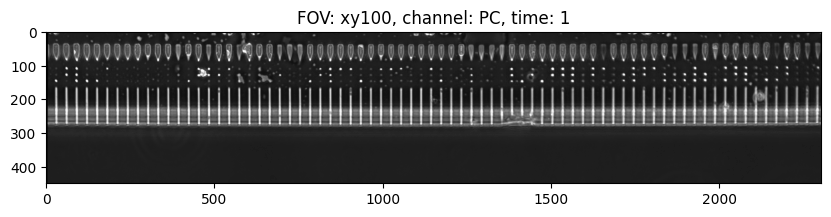

In [17]:
#Indexing using numbers
#an_image = my_experiment.get_image(FOV = 1, channel = 0, time = 1, plot = True, registered = True)
#Indexing using channel and FOV names
an_image = my_experiment.get_image(FOV = "xy100", channel = "PC", time = 1, plot = True, registered = True)

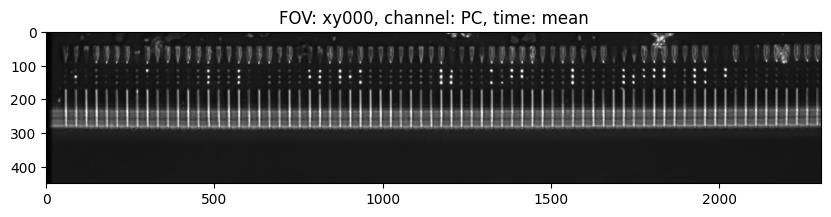

In [18]:
#Getting the mean of a timestack for a particular FOV
a_mean_image = my_experiment.get_mean_of_timestack(0, 0, plot=True)

In [ ]:
mean_timestacks = [my_experiment.get_mean_of_timestack(FOV, "PC", ) for FOV in my_experiment.FOVs]

### Finding the x limits

In [24]:
## If discarding FOVs later in the code, start re-running from here

In [25]:
# use this cell to discard FOVs 
discard_FOVs = []
discard_FOVs = [f"xy{str(x).zfill(3)}" for x in discard_FOVs]
my_experiment.discard_FOVs(discard_FOVs)
my_experiment.FOVs

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


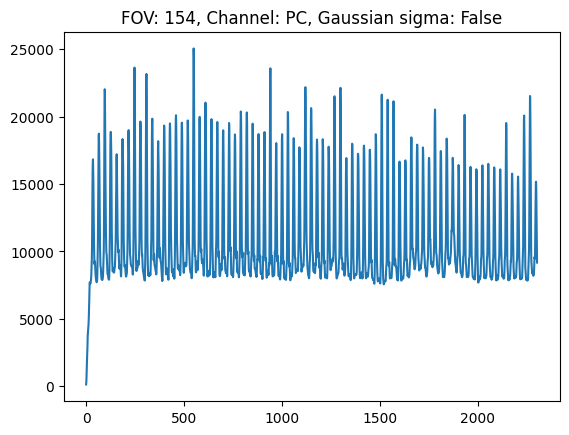

In [26]:
# Getting the mean of the timestack over the x direction
a_t_x_mean = my_experiment.mean_t_x(154, my_experiment.registration_channel, plot = True)

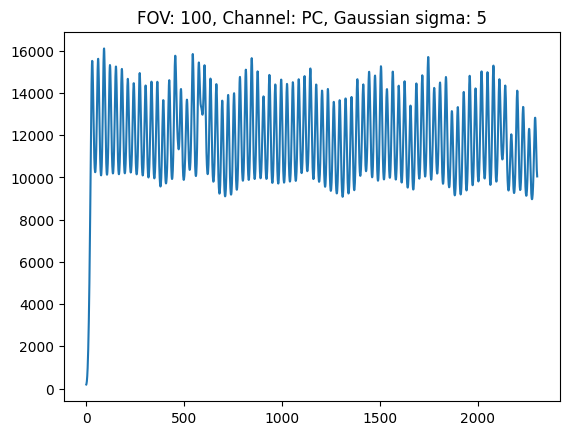

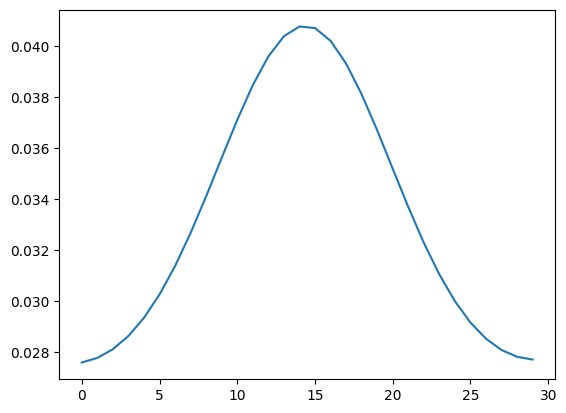

In [31]:
#Adding a gaussian blurring using the sigma argument
sigma = 5

# Use a convolution filter if gaussian blurring isn't working well
a_t_x_mean = my_experiment.mean_t_x(100, my_experiment.registration_channel, sigma = sigma, plot = True)
f = deepcopy(a_t_x_mean[1011:1041]) #adjust
f = f/f.sum()
plt.plot(f)

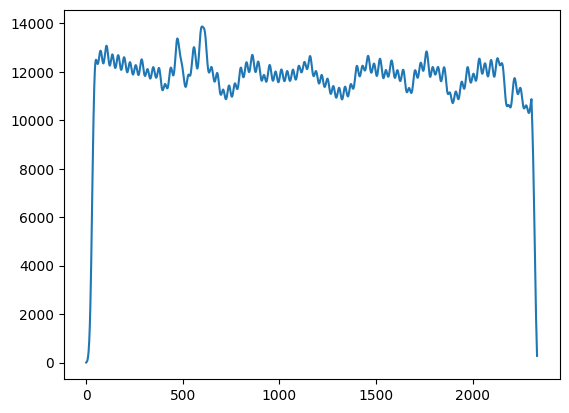

In [32]:
convolution = np.convolve(a_t_x_mean, f)
plt.plot(convolution)

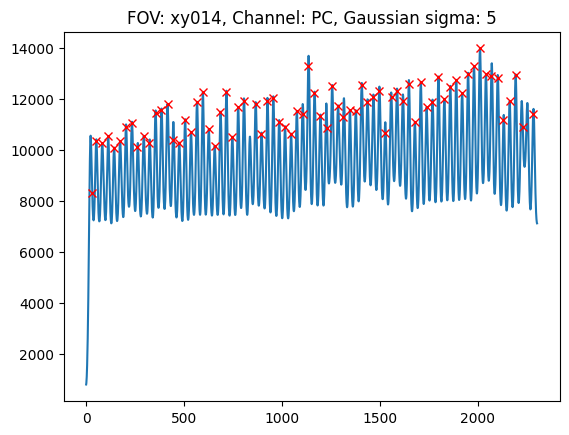

(450, 2304)


In [33]:
# Now finding trench peaks for a particular FOV, giving a distance argument, and using our sigma value from before
distance = 20
prominence=10
peaks = my_experiment.find_trench_peaks("xy014", 
                                        my_experiment.registration_channel, 
                                        sigma = sigma, distance = distance, 
                                        prominence=prominence, 
                                        conv_filter=f,
                                        plot = True)
print(my_experiment.dims)

We've found good values for `sigma` and `distance`.
Let's now call `find_all_trench_x_positions` on the phase contrast channel to identify all the x limits of the trenches in every FOV

In [34]:
trench_x_positions = my_experiment.find_all_trench_x_positions(my_experiment.registration_channel, 
                                                               sigma = sigma, 
                                                               distance = distance, 
                                                               prominence=prominence, 
                                                               conv_filter=f,
                                                               shrink_scale = 4, 
                                                               trench_width = 24,
                                                               plot = False, 
                                                               plot_save=True)

Using the trench width specified by trench_width. Please ensure this parameter is an appropriate integer


### Discard any bad trenches

In [35]:
# Check diagnostics on imageJ, discard trenches with bad crop and broken trenches. Can remove major artefacts, but small ones should be easy to remove later
my_experiment.discard_trenches([])

### Finding the y limits
So we've successfully found the x limits of the trenches. Let's now find the y limits

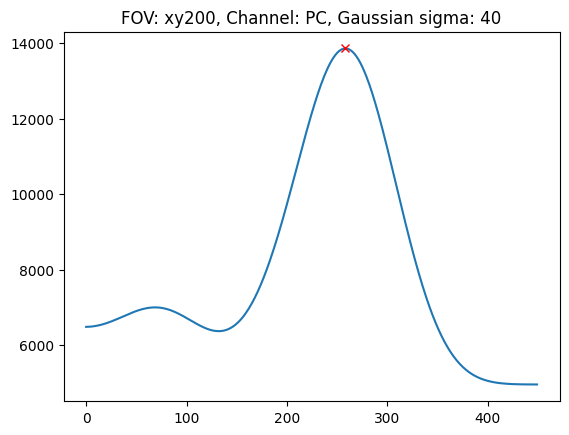

In [36]:
#Adding a gaussian blurring using the sigma argument
sigma = 40
height = 2000
distance = my_experiment.dims[0]
a_t_y_mean, y_peak = my_experiment.find_lane_peaks("xy200", sigma = sigma, distance = distance, height=height, plot = True)

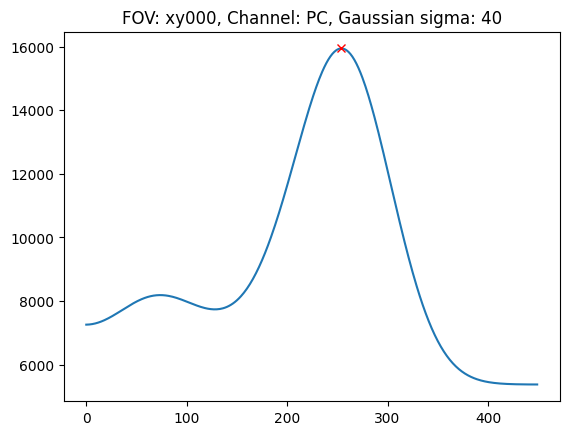

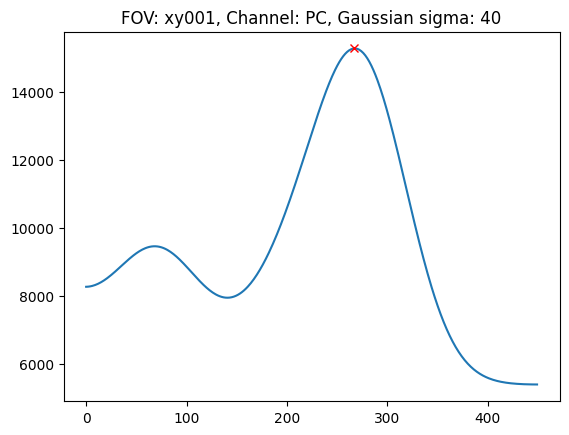

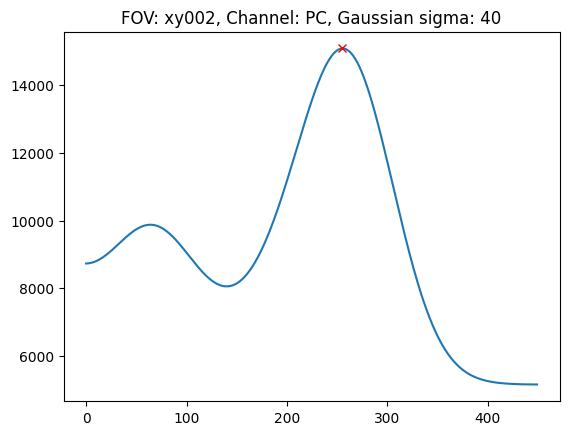

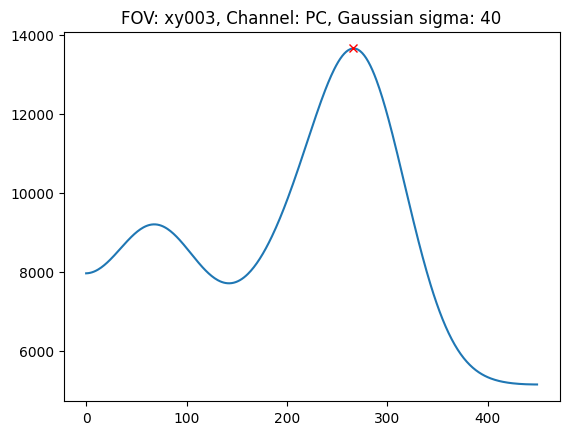

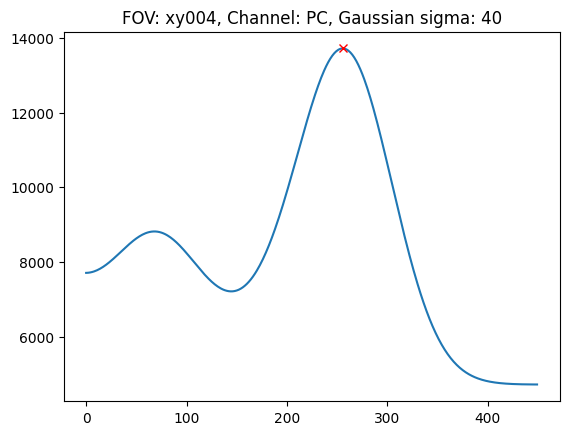

...

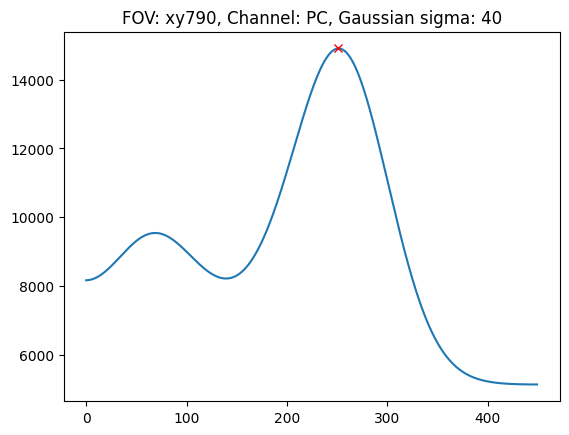

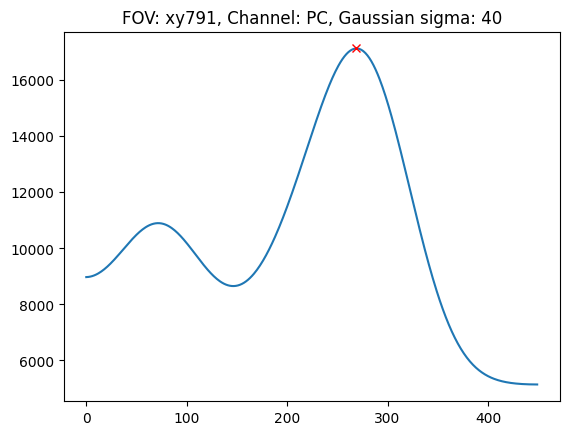

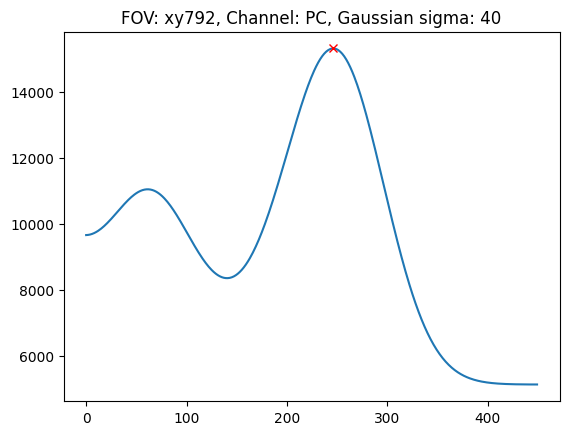

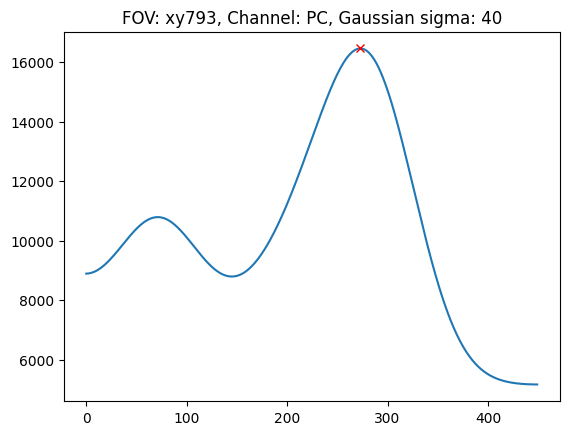

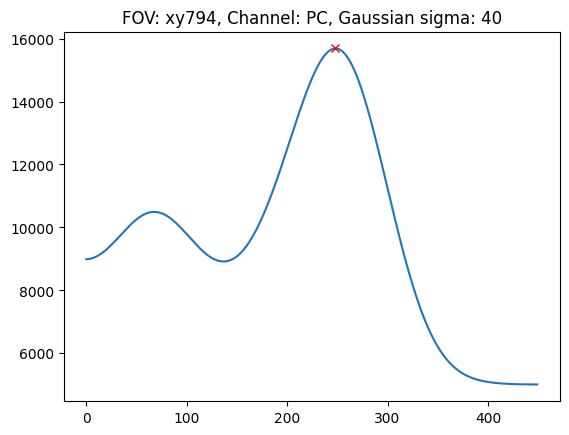

In [37]:
# Calculate and store y peaks for each FOV
# Collect peaks and image heights for each FOV
y_peaks = {}
image_heights = {}

for FOV in my_experiment.FOVs:
    mean_img, peaks = my_experiment.find_lane_peaks(
        FOV, 
        sigma=sigma, 
        distance=distance, 
        height=height, 
        plot=True  # Set to True if you want to visualize the peaks
    )
    y_peaks[FOV] = peaks
    image_heights[FOV] = len(mean_img)  # mean_img is 1D array of length equal to image height

In [38]:
# Check if any FOVs have 0 y peaks identified (will need to either adjust parameters or delete these FOVs
# Identify FOVs with no y-peaks
FOVs_with_no_peaks = [FOV for FOV, peaks in y_peaks.items() if len(peaks) == 0]

# Print the FOVs with no peaks
if FOVs_with_no_peaks:
    print("FOVs with no peaks identified:")
    for FOV in FOVs_with_no_peaks:
        print(f" - {FOV}")
else:
    print("All FOVs have at least one peak identified.")

All FOVs have at least one peak identified.


In [39]:
my_experiment.FOVs

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


In [40]:
# Discard FOVs with no y-peaks
my_experiment.discard_FOVs(FOVs_with_no_peaks)
my_experiment.FOVs
# IF DISCARDING FOVs, NEED TO RE-RUN X PEAK FINDER AND SUBSEQUENT CHUNKS OF CODE (RUN OFFSET CHECKING CODE BELOW FIRST THOUGH)

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


Set the y offsets from the halo (knowing the trench length can be helpful here)

In [41]:
# Check min distances of peaks from top and bottom to set appropriate offsets
# Dictionaries to store minimum distances for each FOV
min_distances_to_top = {}
min_distances_to_bottom = {}

for FOV in my_experiment.FOVs:
    peaks = y_peaks[FOV]
    img_height = image_heights[FOV]

    # Distances from peaks to the top edge (y=0)
    distances_to_top = peaks  # Peaks are at positions along Y-axis
    min_distance_to_top = np.min(distances_to_top)
    min_distances_to_top[FOV] = min_distance_to_top

    # Distances from peaks to the bottom edge
    distances_to_bottom = img_height - peaks
    min_distance_to_bottom = np.min(distances_to_bottom)
    min_distances_to_bottom[FOV] = min_distance_to_bottom

# Determine global minimum distances
global_min_distance_to_top = min(min_distances_to_top.values())
global_min_distance_to_bottom = min(min_distances_to_bottom.values())

print(f"\nGlobal minimum distance to top edge: {global_min_distance_to_top} pixels")
print(f"Global minimum distance to bottom edge: {global_min_distance_to_bottom} pixels")


Global minimum distance to top edge: 234 pixels
Global minimum distance to bottom edge: 151 pixels


In [42]:
my_experiment.trench_y_offsets = (-25+135, -25) # long crop for entire trench, minimal pixels above as don't need to background sub

In [43]:
# Discard FOVs with trenches too close to the top/bottom
# List to store FOVs that need to be discarded
FOVs_to_discard_due_to_offsets = []

for FOV in my_experiment.FOVs:
    min_top = min_distances_to_top[FOV]
    min_bottom = min_distances_to_bottom[FOV]
    if min_top < my_experiment.trench_y_offsets[0] or min_bottom < -my_experiment.trench_y_offsets[1]:
        FOVs_to_discard_due_to_offsets.append(FOV)
        
# Print FOVs that will be discarded
if FOVs_to_discard_due_to_offsets:
    print("FOVs to discard due to insufficient distances for trench_y_offsets:")
    for FOV in FOVs_to_discard_due_to_offsets:
        print(f" - {FOV}")
else:
    print("All FOVs have sufficient distances for the specified trench_y_offsets.")

All FOVs have sufficient distances for the specified trench_y_offsets.


In [44]:
# Discard the identified FOVs
my_experiment.discard_FOVs(FOVs_to_discard_due_to_offsets)
my_experiment.FOVs
# IF DISCARDING FOVs, NEED TO RE-RUN X PEAK FINDER AND SUBSEQUENT CHUNKS OF CODE

['xy000',
 'xy001',
 'xy002',
 'xy003',
 'xy004',
 'xy005',
 'xy006',
 'xy007',
 'xy008',
 'xy009',
 'xy010',
 'xy011',
 'xy012',
 'xy013',
 'xy014',
 'xy015',
 'xy016',
 'xy017',
 'xy018',
 'xy019',
 'xy020',
 'xy021',
 'xy022',
 'xy023',
 'xy024',
 'xy025',
 'xy026',
 'xy027',
 'xy028',
 'xy029',
 'xy030',
 'xy031',
 'xy032',
 'xy033',
 'xy034',
 'xy035',
 'xy036',
 'xy037',
 'xy038',
 'xy039',
 'xy040',
 'xy041',
 'xy042',
 'xy043',
 'xy044',
 'xy045',
 'xy046',
 'xy047',
 'xy048',
 'xy049',
 'xy050',
 'xy051',
 'xy052',
 'xy053',
 'xy054',
 'xy055',
 'xy056',
 'xy057',
 'xy058',
 'xy059',
 'xy060',
 'xy061',
 'xy062',
 'xy063',
 'xy064',
 'xy065',
 'xy066',
 'xy067',
 'xy068',
 'xy069',
 'xy070',
 'xy071',
 'xy072',
 'xy073',
 'xy074',
 'xy075',
 'xy076',
 'xy077',
 'xy078',
 'xy079',
 'xy080',
 'xy081',
 'xy082',
 'xy083',
 'xy084',
 'xy085',
 'xy086',
 'xy087',
 'xy088',
 'xy089',
 'xy090',
 'xy091',
 'xy092',
 'xy093',
 'xy094',
 'xy095',
 'xy096',
 'xy097',
 'xy098',
 'xy099',


Check that only one y peak has been found for each FOV

Find the y limits

In [45]:
y_peaks = my_experiment.find_all_trench_y_positions_PC(channel=my_experiment.PC_channel,sigma=sigma,distance=distance,height=height,plot=False, plot_save=True)

### Extract the trenches as png

In [53]:
#my_experiment.extract_trenches(force=True)

In [54]:
#print(len(os.listdir("trenches")))

# GEORGEOS SUPER CODE

In [46]:
from dask.distributed import LocalCluster
cluster = LocalCluster()          # Fully-featured local Dask cluster
client = cluster.get_client()
cluster.adapt(minimum=1, maximum=10) # set to 10 to allow for spare CPU power
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 8
Total threads: 32,Total memory: 125.62 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:42017,Workers: 8
Dashboard: http://127.0.0.1:8787/status,Total threads: 32
Started: Just now,Total memory: 125.62 GiB
Comm: tcp://127.0.0.1:34529,Total threads: 4
Dashboard: http://127.0.0.1:40881/status,Memory: 15.70 GiB
Nanny: tcp://127.0.0.1:33965,


In [ ]:
# MODIFY TO BE UNCOMPRESSED, COMPRESSION SLOWS DOWN SEGMENTATION, CAN COMPRESS LATER

In [47]:
import dask.array as da
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from dask.array import image as da_image

def img_path_generator(directory, FOV, channel, time, file_extension):
    FOV, channel, time = my_experiment.coordinate_converter(FOV, channel, time)
    return f"{directory}/{FOV}_{channel}_{time}.{file_extension}"
def png_imreader(filename):
    return np.array(Image.open(filename))
def get_image(FOV, channel, time, registered=False, *, plot=False, rotation=False):
    test_dir = img_path_generator(my_experiment.registered_dir, FOV, channel, time, "png")
    image = png_imreader(test_dir)
    return image

import zarr
from numcodecs import Blosc
from glob import glob
import numpy as np
from tqdm.auto import tqdm

n_trenches = 0
max_trenches_per_FOV = 0
for FOV in my_experiment.FOVs:
    x_pos = my_experiment.pruned_experiment_trench_x_lims[FOV]
    trenches_in_FOV = len(x_pos)
    if trenches_in_FOV > max_trenches_per_FOV:
        max_trenches_per_FOV = trenches_in_FOV
    n_trenches += trenches_in_FOV


trench_num = 0
trench_id_dict = dict()
for FOV in my_experiment.FOVs:
    y_pos = my_experiment.y_peaks[FOV][0]
    x_pos = my_experiment.pruned_experiment_trench_x_lims[FOV]
    trenches_id = []
    if type(x_pos) == dict:
        for key, value in x_pos.items():
            trenches_id.append([value, y_pos, trench_num])
            trench_num += 1
        trench_id_dict[FOV] = trenches_id

if type(x_pos) == dict:
    trench_x_size = list(x_pos.values())[0][1] - list(x_pos.values())[0][0]
else:
    trench_x_size = x_pos[0][1] - x_pos[0][0]
trench_y_size = my_experiment.trench_y_offsets[0] - my_experiment.trench_y_offsets[1]

all_trench_data_da = []

for FOV in tqdm(my_experiment.FOVs):

    pattern = os.path.join(my_experiment.registered_dir, f"{FOV}_PC_*.png")
    FOV_stack_da = da_image.imread(pattern) # skip GFP for now, will need to re-write for multi-channel zarr arrays
    FOV_stack_da = FOV_stack_da.rechunk(FOV_stack_da.shape)

    trench_arrays = []

    for (L, R), y_pos, tr_num in trench_id_dict[FOV]:
        # Define the y-slice (Top to Bottom)
        y_start = y_pos - my_experiment.trench_y_offsets[0]
        y_end = y_pos - my_experiment.trench_y_offsets[1]

        # Define the x-slice (Left to Right)
        x_start = L
        x_end = R

        # Slice the FOV stack to extract one trench. Dask handles this efficiently.
        # The first ':' selects all time points/channels in the stack.
        single_trench_da = FOV_stack_da[:, y_start:y_end, x_start:x_end]

        # Add the resulting Dask array (representing one trench over time) to our list
        trench_arrays.append(single_trench_da)

    # Stack all the trench arrays along a new first dimension (axis=0)
    # This creates a single Dask array of shape (n_trenches, n_frames, height, width)
    all_trenches_in_FOV = da.stack(trench_arrays, axis=0)

    current_trenches = all_trenches_in_FOV.shape[0]
    padding_needed = max_trenches_per_FOV - current_trenches

    # 2. Define the padding for each dimension in the format ((before_axis0, after_axis0), (before_axis1, after_axis1), ...)
    pad_widths = (
        (0, padding_needed),  # Pad only at the end of the first dimension
        (0, 0),               # No padding for the second dimension
        (0, 0),               # No padding for the third dimension
        (0, 0)                # No padding for the fourth dimension
    )

    # 3. Apply the padding using mode='constant' and a value of 0
    all_trenches_in_FOV = da.pad(
        all_trenches_in_FOV,
        pad_width=pad_widths,
        mode='constant',
        constant_values=0
    )

    all_trenches_in_FOV = all_trenches_in_FOV.rechunk(all_trenches_in_FOV.shape)
    all_trenches_in_FOV = da.expand_dims(all_trenches_in_FOV, axis=2)
    all_trench_data_da.append(all_trenches_in_FOV)
master_trench_da = da.concatenate(all_trench_data_da,axis=0)
master_trench_da
compressor = Blosc(cname='zstd', clevel=9, shuffle=Blosc.BITSHUFFLE)
da.to_zarr(master_trench_da, "trenches.zarr", storage_options={"compressor": compressor}, overwrite=True)

  0%|          | 0/795 [00:00<?, ?it/s]

/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/distributed/client.py:3358: UserWarning: Sending large graph of size 46.38 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(
2025-12-30 11:37:13,437 - tornado.application - ERROR - Exception in callback <bound method Worker.trigger_profile of <Worker 'tcp://127.0.0.1:37657', name: 9, status: running, stored: 114, running: 4/4, ready: 60, comm: 0, waiting: 0>>
Traceback (most recent call last):
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/tornado/ioloop.py", line 919, in _run
    val = self.callback()
          ^^^^^^^^^^^^^^^
  File "/home/ka537/miniconda3/envs/extraction/lib/python3.11/site-packages/distributed/worker.py", line 2441, in trigger_profile

In [61]:
# Check progress in dask client

In [1]:
discard_FOVs = [150, 151, 152, 153, 154, 155, 156, 157, 158]
discard_FOVs

[150, 151, 152, 153, 154, 155, 156, 157, 158]

In [2]:
split_factor = 5

# Generate the new list
discard_FOVs = [
    sub_fov 
    for fov in discard_FOVs 
    for sub_fov in range(fov * split_factor, (fov + 1) * split_factor)
]

print(discard_FOVs)

[750, 751, 752, 753, 754, 755, 756, 757, 758, 759, 760, 761, 762, 763, 764, 765, 766, 767, 768, 769, 770, 771, 772, 773, 774, 775, 776, 777, 778, 779, 780, 781, 782, 783, 784, 785, 786, 787, 788, 789, 790, 791, 792, 793, 794]


In [3]:
# Define channels and discard_FOVs
import json

# 1. Define Settings
channels = ['PC'] # change to actual channels

# 2. Create Config Dictionary
config_data = {
    "channels": channels,
    "channel_indices": {name: i for i, name in enumerate(channels)},
    "discard_FOVs": discard_FOVs
}

# 3. Save to JSON
config_filename = "config.json"
with open(config_filename, "w") as f:
    json.dump(config_data, f, indent=4)

print(f"Configuration saved to {config_filename}")

Configuration saved to config.json


In [62]:
#

2025-12-04 16:07:56,402 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,402 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,402 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,412 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,431 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,446 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,513 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:56,563 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
2025-12-04 16:07:58,727 - distributed.core - INFO - Connection to tcp://127.0.0.1:46793 has been closed.
